In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import KMeans, AffinityPropagation
from fcmeans import FCM
from sklearn import preprocessing
from sklearn.metrics import silhouette_score,calinski_harabasz_score
from sklearn.manifold import TSNE

In [64]:
font1 = {'family' : 'Arial',
'weight' : 'normal',
'size'   : 30,
} #Arial是字体形式

In [3]:
# 看进聚类结果(输出类别中的前m×n条轨迹)
def plot_trajectory(data,m=20,n=5,figsize_x=16,figsize_y=24,color='blue'):
    
    plt.rc(font1)
    fig, ax = plt.subplots(m, n, sharex=True, sharey=True, figsize=(figsize_x,figsize_y),dpi=220)
    for i in range(m):
        for j in range(n):
            flag = i * n + j
            ax[i,j].plot(data[flag],linewidth=1,c=color)
            ax[i,j].set_yticks(np.arange(0,4),['Home','Travel','Work','Others'])
            if len(data[flag])>1440:
                for day in range(1,7):
                    ax[i,j].plot([1440*day,1440*day],[-0.5,3.5],'k--',linewidth = 0.5)
            ax[i,j].set_ylim((-0.2, 3.2))

In [4]:
# 降维查看聚类效果
def tsne_vis(X,result):
#     colors=[[241/255,141/255,0/255],
#             [244/255,180/255,201/255],
#             [255/255,248/255,165/255],
#             [128/255,205/255,227/255],
#             [236/255,122/255,172/255],
#             [73/255,188/255,289/255],
#            [73/255,188/255,289/255]]
    
    tsne = TSNE(random_state=105)
    tsne.fit_transform(X)                               # 进行数据降维到2维
    tsne = pd.DataFrame(tsne.embedding_) # 转换数据格式

    # 画图
    plt.figure(dpi=120)
    for i in range(result.n_clusters):
        d = tsne.loc[np.where(result.labels_ == i)]
        plt.scatter(d[0], d[1], s=5, label='cluster%s'%(i+1))
    plt.xlabel('dimension 1',font1)
    plt.ylabel('dimension 2',font1)
    plt.legend(loc='upper left')

In [5]:
# 亲和力传播初始化的kmeans聚类
def CAK_means(X):
    #计算affinity propagation
    af = AffinityPropagation(damping=0.55,max_iter=500,preference=-2000,random_state=42).fit(X)
    
    cluster_centers_indices = af.cluster_centers_indices_
    init_centroid = X[cluster_centers_indices]
    n_clusters_ = len(cluster_centers_indices)
    
    kmeans = KMeans(n_clusters = n_clusters_, init = init_centroid, random_state = 42, n_init=1)
    kmeans.fit(X)
    
    return kmeans

In [6]:
def cluster_estimate(X):
    inertia = []
    s_scores = []
    for n in range(2 , 11):
        algorithm = (KMeans(n_clusters = n ,init='k-means++', n_init = 10 ,max_iter=300, 
                            tol=0.0001,  random_state= 111  , algorithm='elkan') )
        algorithm.fit(X)
        inertia.append(algorithm.inertia_)
        silhouette_avg = silhouette_score(X, algorithm.labels_)
        s_scores.append(silhouette_avg) # data for the silhouette score method
        
    #画出手肘图和轮廓系数图
    fig, ax = plt.subplots(2,1,figsize=(12,10),dpi=120)
    ax[0].plot(np.arange(2 , 11) , inertia , 'o')
    ax[0].plot(np.arange(2 , 11) , inertia , '-' , alpha = 0.5)
    ax[0].set_xlabel('Number of Clusters',font1) , ax[0].set_ylabel('Inertia',font1)
    
    ax[1] = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax[1])
    ax[1].set_xlabel("number of clusters")
    ax[1].set_ylabel("Silhouette score")
    ax[1].axvline(4, ls="--", c="red")
    ax[1].axvline(5, ls="--", c="red")
    ax[1].axvline(6, ls="--", c="red")
    plt.grid()
    #return inertia,s_scores

In [7]:
# 计算每分钟各类活动的占比，从而绘制堆积面积图
def pattern_ratio(trajectory):
    Proporation = np.zeros((4,trajectory.shape[1]))
    for i in range(trajectory.shape[1]):
        for j in range(4):
            Proporation[j,i] = np.sum(trajectory[:,i]==j)/trajectory.shape[0]
    return Proporation

In [8]:
# 导入原始轨迹数据
trajectory = np.loadtxt('data/trajectory_in_week_3ptype_2019_58.txt')
len(trajectory)

1316

## 纯点云拓扑特征

In [9]:
#读入特征
topological_features = np.loadtxt('data/persistence_feature_week_notWTF_2019_58.txt')
np.array(topological_features).shape

(1316, 28)

In [54]:
# 数据标准化
Standardize = preprocessing.StandardScaler()
X = Standardize.fit_transform(topological_features)

In [32]:
# wcss & sihoutte
inertia, s_scores = cluster_estimate(X)

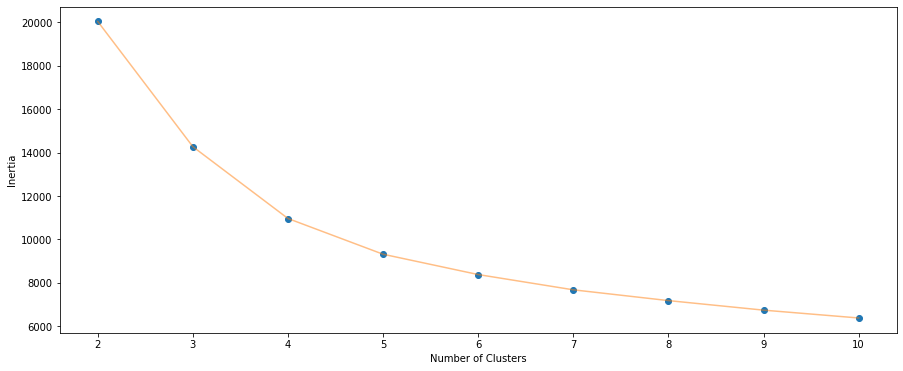

In [28]:
#手肘图
#The Elbow Chart
plt.figure(1 , figsize = (15 ,6))
plt.plot(np.arange(2 , 11) , inertia , 'o')
plt.plot(np.arange(2 , 11) , inertia , '-' , alpha = 0.5)
plt.xlabel('Number of Clusters') , plt.ylabel('Inertia')
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


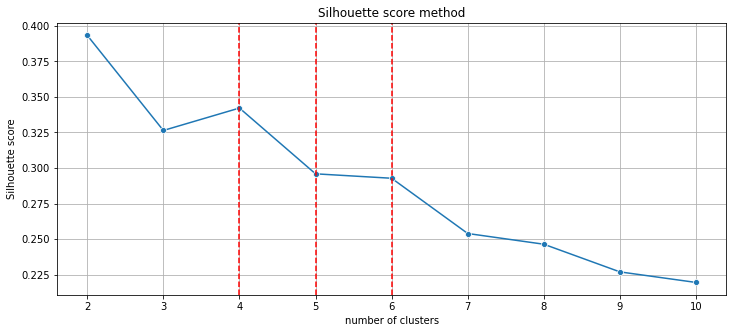

In [34]:
#轮廓系数图
fig, ax = plt.subplots(figsize=(12,5))
ax = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax)
ax.set_title("Silhouette score method")
ax.set_xlabel("number of clusters")
ax.set_ylabel("Silhouette score")
ax.axvline(4, ls="--", c="red")
ax.axvline(5, ls="--", c="red")
ax.axvline(6, ls="--", c="red")
plt.grid()
plt.show()

In [55]:
# 实施聚类
result = CAK_means(X) 

In [56]:
pd.value_counts(result.labels_.reshape(len(X)))

1    439
2    410
0    281
3    186
dtype: int64

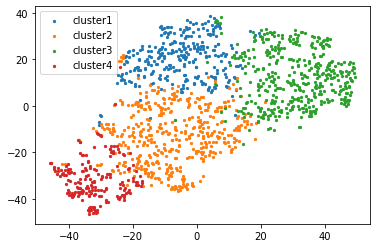

In [146]:
tsne_vis(X,result)

### 代表性序列

In [17]:
# 寻找代表性序列 → 离质心最近的点
def get_centorid_index(X,result):
    index = []
    for c in range(result.n_clusters):
        raw_index = np.arange(len(X))[np.where(result.labels_==c)]
        Data = X[np.where(result.labels_==c)]           
        D = []
        for data in Data:
            dist = np.linalg.norm(data-result.cluster_centers_[c])
            D.append(dist)
        i = np.argmax(np.array(D))
        index.append(raw_index[i])
    return index

In [88]:
index = get_centorid_index(X,result)

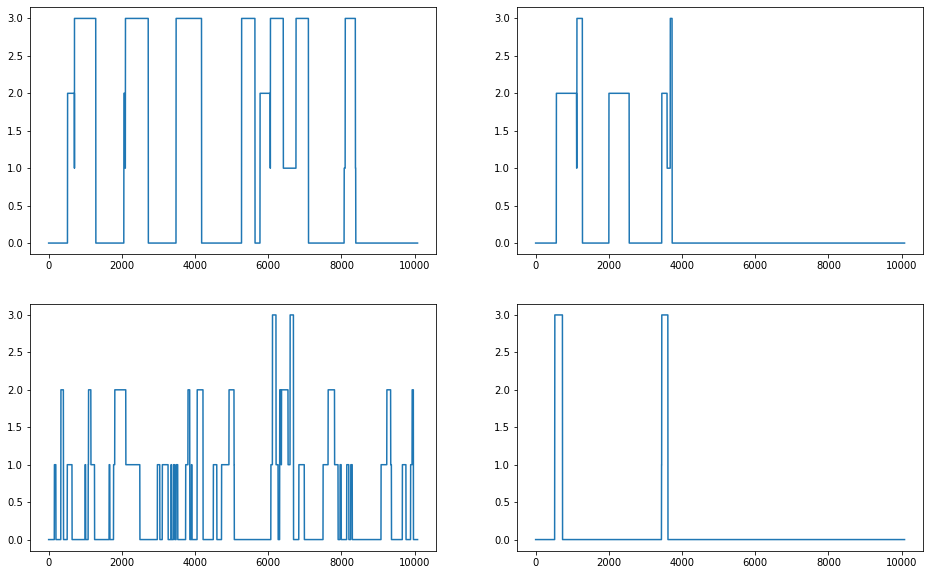

In [98]:
# 画出代表性序列
fig,ax = plt.subplots(2,2,figsize=(16,10))
ax[0,0].plot(trajectory[index[0]])
ax[0,1].plot(trajectory[index[1]])
ax[1,0].plot(trajectory[index[2]])
ax[1,1].plot(trajectory[index[3]])

In [129]:
# 另一种方法 → 每分钟的频次累加
def pattern_accurate(trajectory,result):
    Represent = []
    for c in range(result.n_clusters):
        Data = trajectory[np.where(result.labels_==c)]
        represent=[]
        for i in range(trajectory.shape[1]):
            data = pd.value_counts(Data[:,i]).index[0]
            represent.append(data)
        Represent.append(represent)
    return Represent

In [130]:
represent_trajectory = pattern_accurate(trajectory,result)

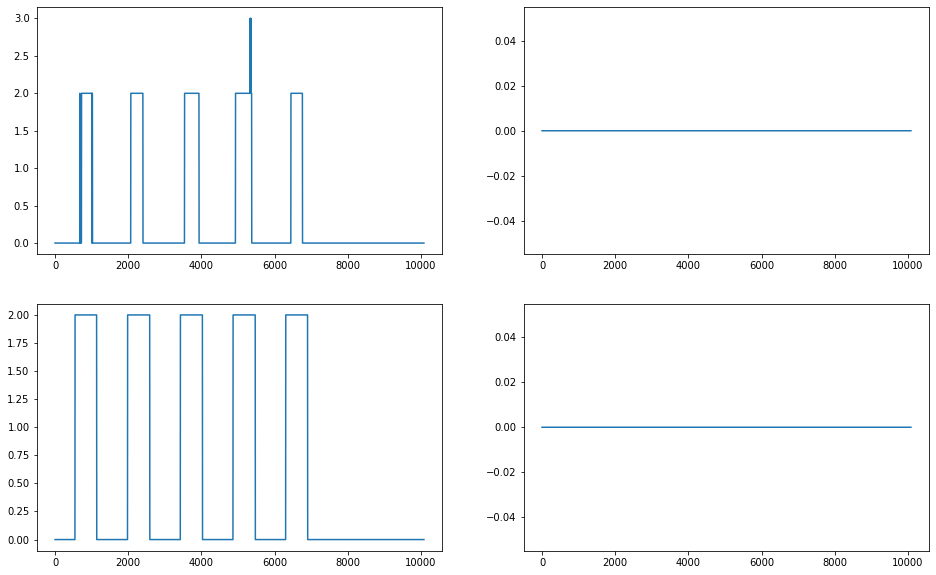

In [131]:
# 画出代表性序列
fig,ax = plt.subplots(2,2,figsize=(16,10))
ax[0,0].plot(represent_trajectory[0])
ax[0,1].plot(represent_trajectory[1])
ax[1,0].plot(represent_trajectory[2])
ax[1,1].plot(represent_trajectory[3])

### 画出类别中的前100条轨迹看看

In [57]:
trajectory_0 = trajectory[np.where(result.labels_==0)]
trajectory_1 = trajectory[np.where(result.labels_==1)]
trajectory_2 = trajectory[np.where(result.labels_==2)]
trajectory_3 = trajectory[np.where(result.labels_==3)]

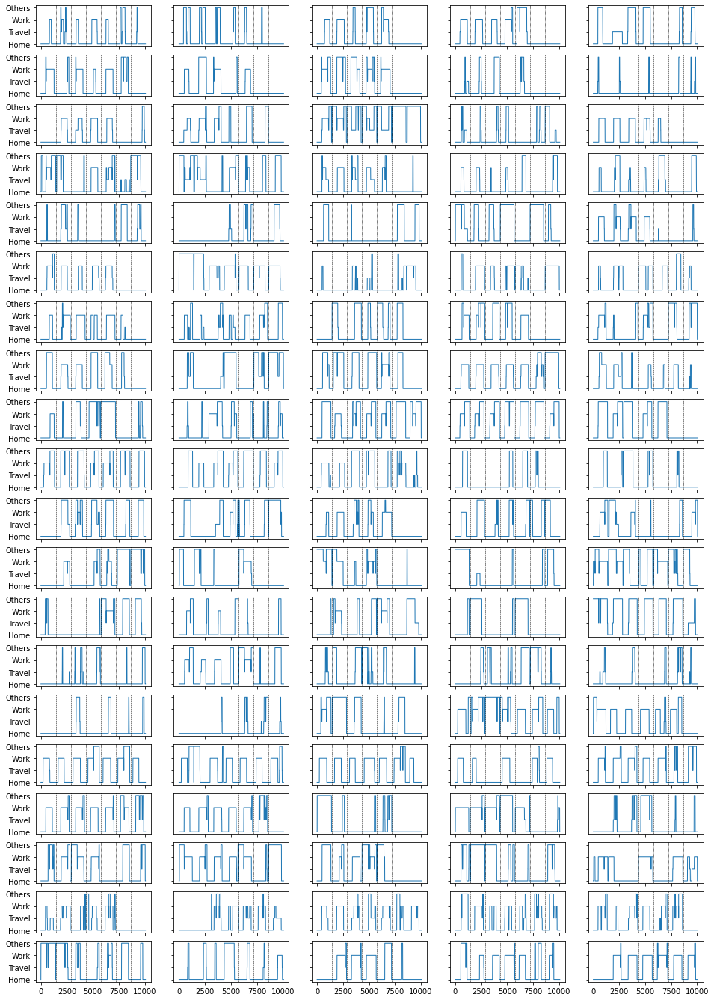

In [111]:
plot_trajectory(trajectory_0)

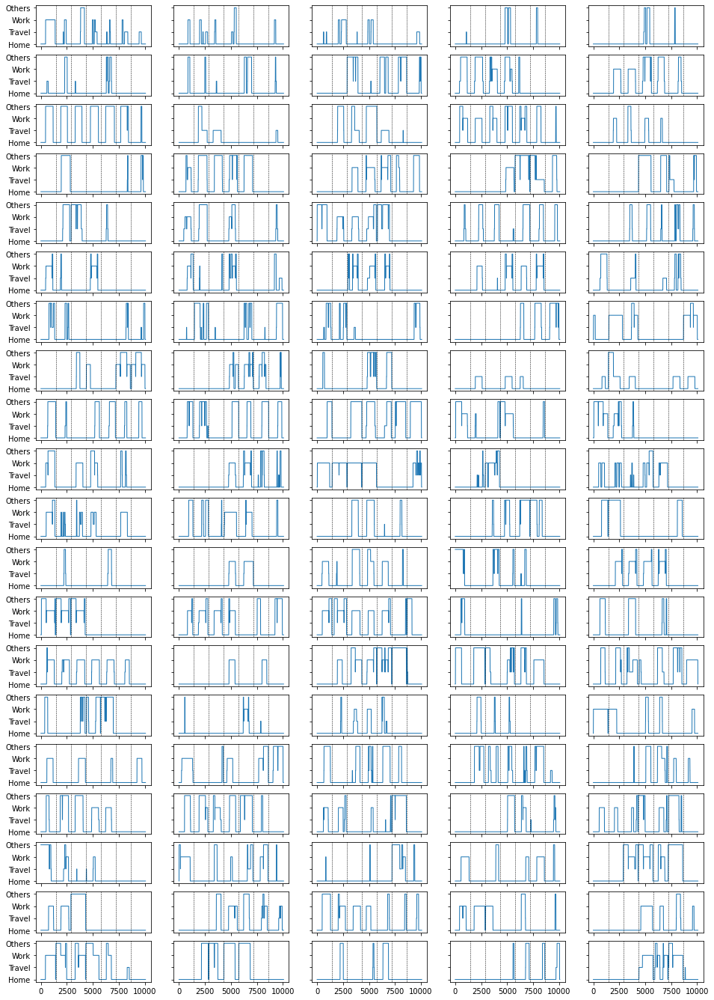

In [112]:
plot_trajectory(trajectory_1)

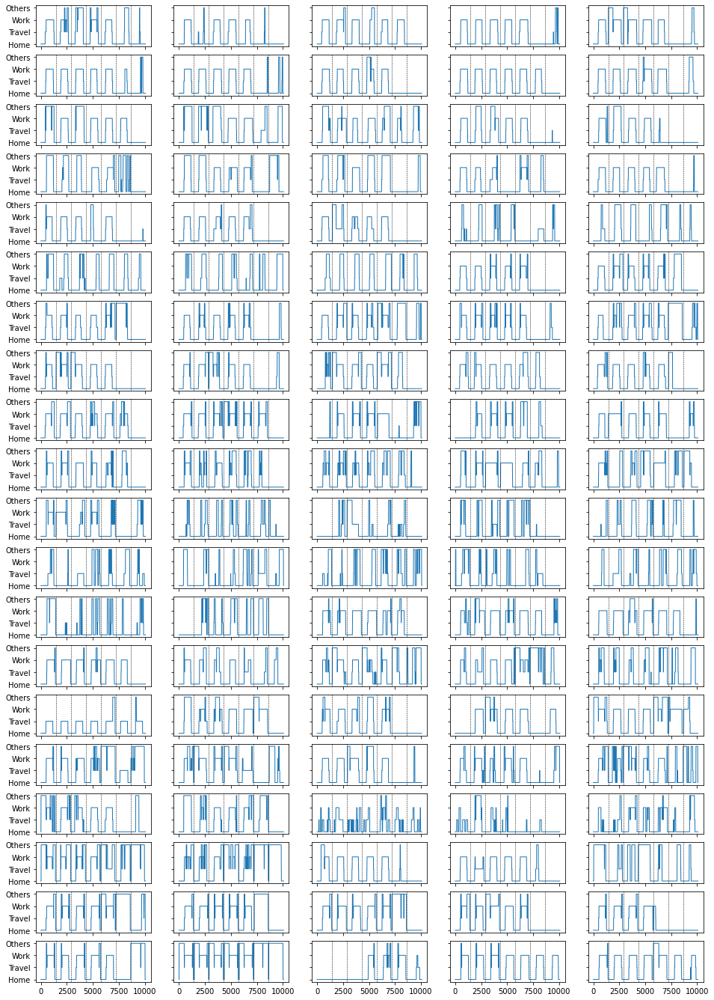

In [113]:
plot_trajectory(trajectory_2)

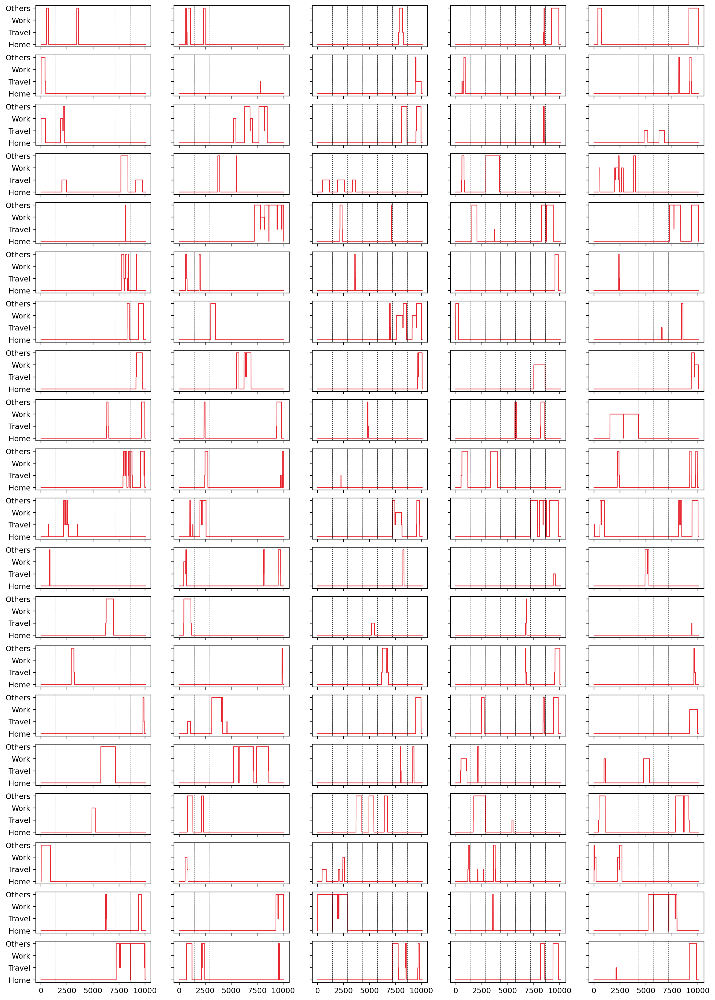

In [58]:
plot_trajectory(trajectory_3,color=[231/255,36/255,46/255])

## 点云拓扑特征和wtf拓扑特征结合

In [10]:
wtf_features = np.loadtxt('data/persistence_features_week_2019_58.txt')
np.array(wtf_features).shape

(1316, 14)

In [11]:
#特征拼接
features = np.hstack((topological_features,wtf_features))
features.shape

(1316, 42)

In [12]:
# 数据标准化
Standardize = preprocessing.StandardScaler()
X = Standardize.fit_transform(features)

In [12]:
# wcss & sihoutte
inertia, s_scores = cluster_estimate(X)

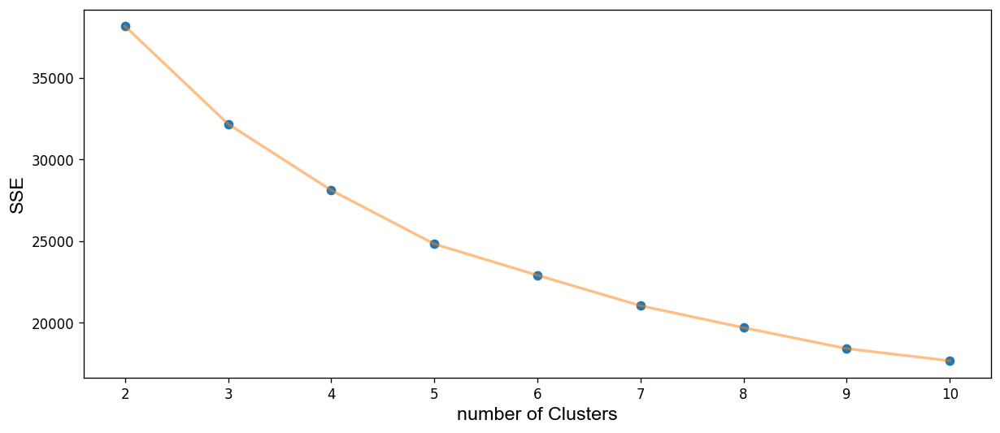

In [15]:
#手肘图
#The Elbow Chart
plt.figure(1 ,figsize = (12 ,5),dpi=120) #, figsize = (15 ,6)
plt.plot(np.arange(2 , 11) , inertia , 'o')
plt.plot(np.arange(2 , 11) , inertia , '-' , alpha = 0.5,linewidth=2)
plt.xlabel('number of Clusters',font1) , plt.ylabel('SSE',font1)
plt.show()

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


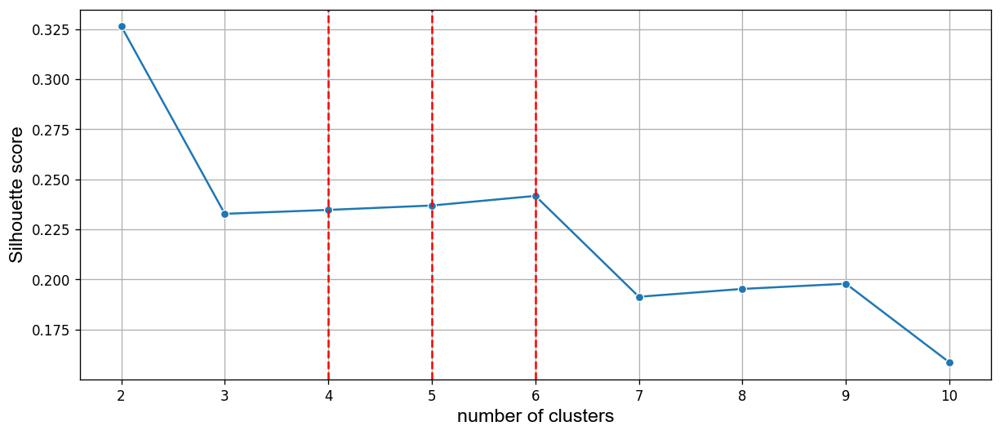

In [222]:
#轮廓系数图
fig, ax = plt.subplots(figsize=(12,5),dpi=120)  #figsize=(12,5)
ax = sns.lineplot(np.arange(2 , 11), s_scores, marker='o', ax=ax)
#ax.set_title("Silhouette score method")
ax.set_xlabel("number of clusters",font1)
ax.set_ylabel("Silhouette score",font1)
ax.axvline(4, ls="--", c="red")
ax.axvline(5, ls="--", c="red")
ax.axvline(6, ls="--", c="red")
plt.grid()
plt.show()

In [13]:
# 实施聚类
result_1 = CAK_means(X) 

In [14]:
result_1.n_clusters

6

In [12]:
np.savetxt('data/trajectory_labels.txt',result_1.labels_)

In [21]:
# 降维查看聚类效果
def tsne_vis1(X,n,labels):
#     colors=[[241/255,141/255,0/255],
#             [244/255,180/255,201/255],
#             [255/255,248/255,165/255],
#             [128/255,205/255,227/255],
#             [236/255,122/255,172/255],
#             [73/255,188/255,289/255],
#            [73/255,188/255,289/255]]
    
    tsne = TSNE(random_state=105)
    tsne.fit_transform(X)                               # 进行数据降维到2维
    tsne = pd.DataFrame(tsne.embedding_) # 转换数据格式

    # 画图
    plt.figure(dpi=120)
    for i in range(n):
        d = tsne.loc[np.where(labels == i)]
        plt.scatter(d[0], d[1], s=5, label='cluster%s'%(i+1))
    plt.xlabel('dimension 1',font1)
    plt.ylabel('dimension 2',font1)
    plt.legend(loc='upper left')

In [30]:
labels = result_1.labels_
labels = labels.reshape(labels.shape[0])

In [35]:
for i in range(len(labels)):
    if labels[i]==4:
        labels[i]=0
    if labels[i]==5:
        labels[i]=4

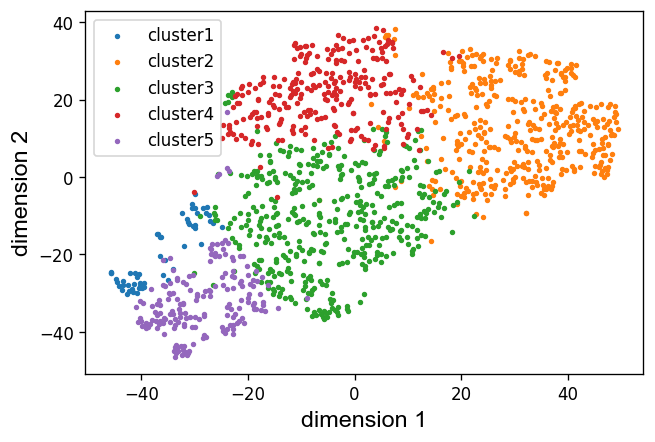

In [37]:
tsne_vis1(X,5,labels)

### 代表性序列

In [18]:
index = get_centorid_index(X,result_1)

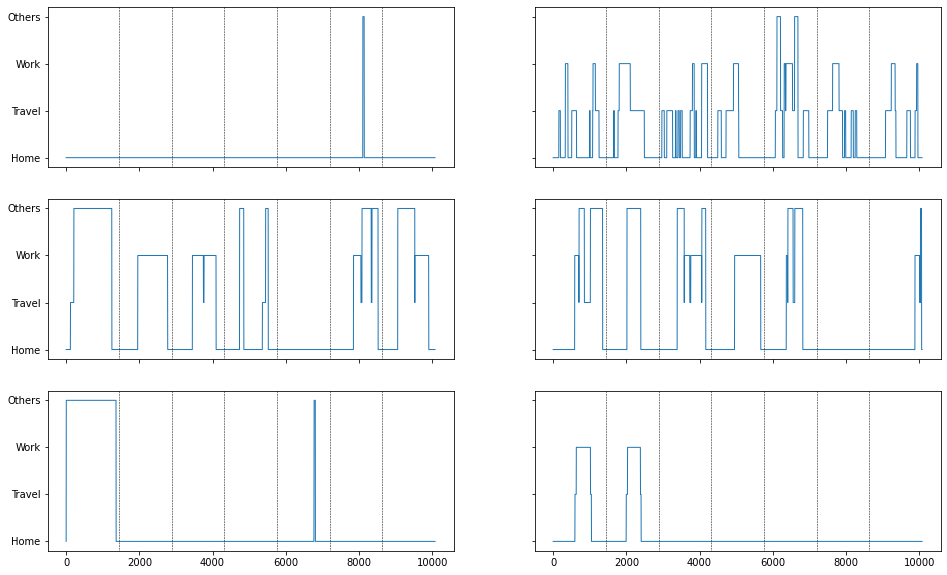

In [90]:
# 画出代表性序列
plot_trajectory(trajectory[index],m=3,n=2,figsize_x=16,figsize_y=10)

### 人工筛选代表性序列

In [58]:
def plot_represent(trajectory,color='blue'):
    fig = plt.figure(figsize=(16,5),dpi=200)
    ax = fig.add_subplot(1,1,1)
    plt.plot(trajectory,c=color)
#     for day in range(1,7):
#         plt.plot([1440*day,1440*day],[-0.5,3.5],'k--',linewidth = 0.5)
    ax.set_xticks(np.arange(0,10081,360),['00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','24:00'],rotation=300)
    ax.set_yticks(np.arange(0,4),['Home','Travel','Work','Others'])
    ax.set_xlim([0,10080])
    for i in range (7):
        ax.axvline(1440*i, ls="--", c="darkgray")
    x = np.arange(10080)
    def forward(x):
        return x

    def inverse(x):
        return x
    secax = ax.secondary_xaxis('top', functions=(forward, inverse))
    secax.set_xticks(np.arange(720,9361,1440),['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])

In [16]:
def act_interval(t):
    starts = [0]
    ends = []
    labels = []
    start= 0
    for i in range(1,len(t)):
        if t[i]!=t[i-1]:
            end = i-1
            ends.append(end)
            labels.append(t[i-1])
            start = i
            starts.append(start)
    #最后一段记录
    end = i
    ends.append(end)
    labels.append(t[i])
    
    return starts,ends,labels

In [70]:
# 用堆积柱状图来表现，人工选取的代表性序列
starts0,ends0,label0=act_interval(trajectory0[5])
starts1,ends1,label1=act_interval(trajectory1[111])
starts2,ends2,label2=act_interval(trajectory2[288])
starts3,ends3,label3=act_interval(trajectory3[73])
starts5,ends5,label5=act_interval(trajectory5[36])

In [62]:
# 用堆积柱状图来表现，自动给出的代表性序列
starts0,ends0,label0=act_interval(trajectory[index][0])
starts1,ends1,label1=act_interval(trajectory[index][1])
starts2,ends2,label2=act_interval(trajectory[index][2])
starts3,ends3,label3=act_interval(trajectory[index][3])
starts5,ends5,label5=act_interval(trajectory[index][5])

In [20]:
color_set = [[127/255,205/255,236/255],
             [255/255,233/255,169/255],
             [242/255,155/255,143/255],
             [85/255,184/255,121/255]]

<ipython-input-72-de223df27ab9>:42: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


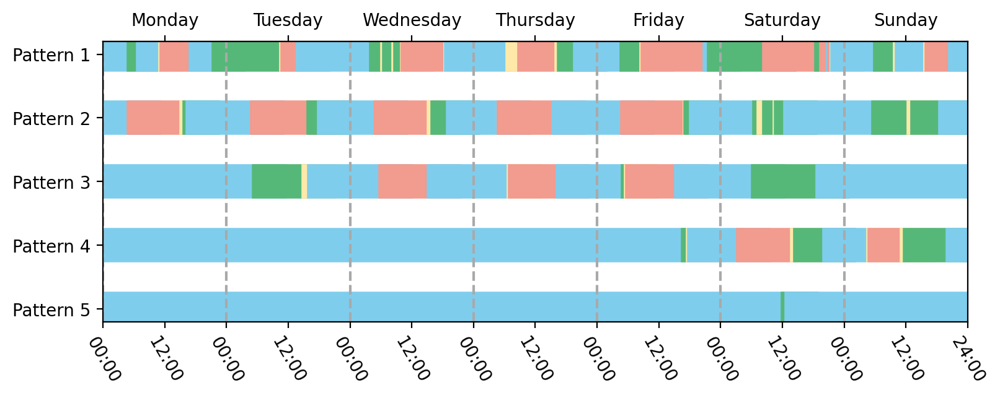

In [72]:
plt.rc(font1)
fig = plt.figure(dpi=200,figsize=(9,3))
ax = fig.add_subplot(1,1,1)

# 设置数据
for i in range(len(starts0)):
    start = starts0[i]; end=ends0[i]; label=label0[i]
    ax.plot([start,end],[1,1],c=color_set[int(label)],linewidth=20)
for i in range(len(starts1)):
    start = starts1[i]; end=ends1[i]; label=label1[i]
    ax.plot([start,end],[5,5],c=color_set[int(label)],linewidth=20)
for i in range(len(starts2)):
    start = starts2[i]; end=ends2[i]; label=label2[i]
    ax.plot([start,end],[3,3],c=color_set[int(label)],linewidth=20)
for i in range(len(starts3)):
    start = starts3[i]; end=ends3[i]; label=label3[i]
    ax.plot([start,end],[4,4],c=color_set[int(label)],linewidth=20)
for i in range(len(starts5)):
    start = starts5[i]; end=ends5[i]; label=label5[i]
    ax.plot([start,end],[2,2],c=color_set[int(label)],linewidth=20)
    
#设置天分隔
for i in range (7):
    ax.axvline(1440*i, ls="--", c="darkgray")

ax.set_xlim(0,10080)
ax.set_xticks(np.arange(0,10081,720),['00:00','12:00','00:00','12:00','00:00','12:00','00:00','12:00','00:00','12:00','00:00','12:00','00:00','12:00','24:00'],rotation=300)
ax.set_yticks(np.arange(1,6,1),['Pattern 5','Pattern 4','Pattern 3','Pattern 2','Pattern 1'])

#设置双x轴
x = np.arange(10080)
def forward(x):
    return x

def inverse(x):
    return x

secax = ax.secondary_xaxis('top', functions=(forward, inverse))
secax.set_xticks(np.arange(720,9361,1440),['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])


fig.show()

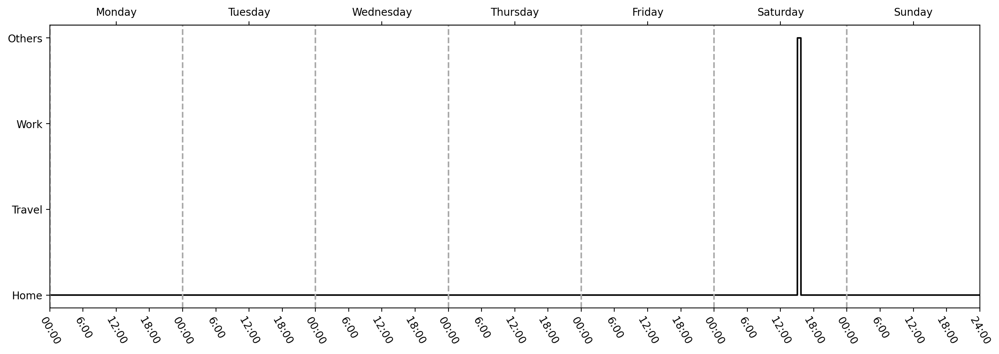

In [59]:
plot_represent(trajectory0[5],color=[0,0,0])

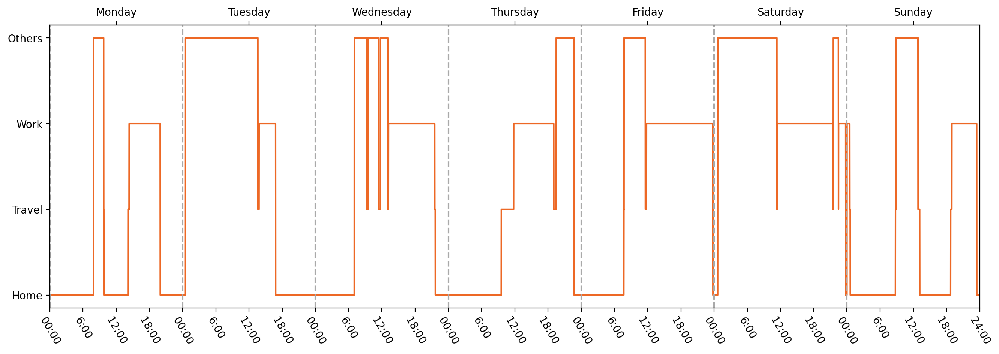

In [60]:
plot_represent(trajectory1[111],color=[237/255,104/255,37/255])

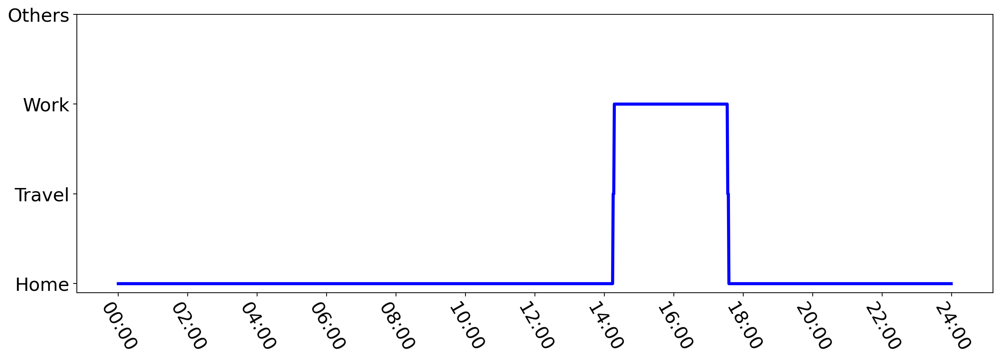

In [74]:
plt.rcParams.update({"font.size":18})
fig = plt.figure(figsize=(16,5),dpi=200)
ax = fig.add_subplot(1,1,1)
plt.plot(trajectory[1,0:1440],c='blue',linewidth=3)
#     for day in range(1,7):
#         plt.plot([1440*day,1440*day],[-0.5,3.5],'k--',linewidth = 0.5)
ax.set_xticks(np.arange(0,1441,120),['00:00','02:00','04:00','06:00','08:00','10:00','12:00','14:00','16:00','18:00','20:00','22:00','24:00'],rotation=300)
ax.set_yticks(np.arange(0,4),['Home','Travel','Work','Others'])

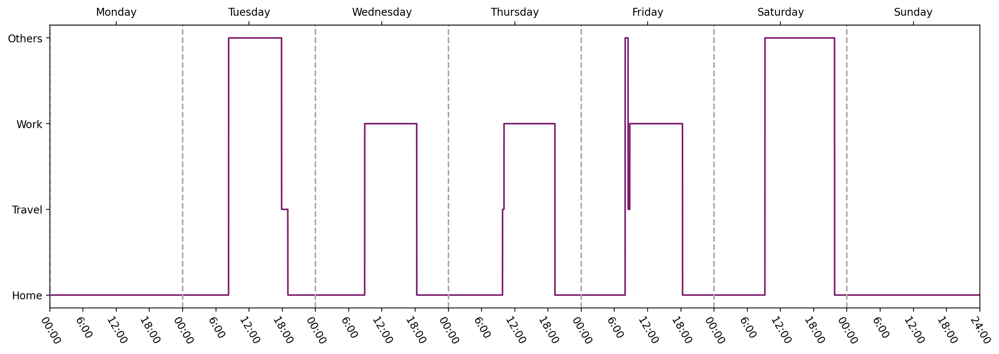

In [61]:
plot_represent(trajectory2[288],color=[122/255,27/255,109/255])

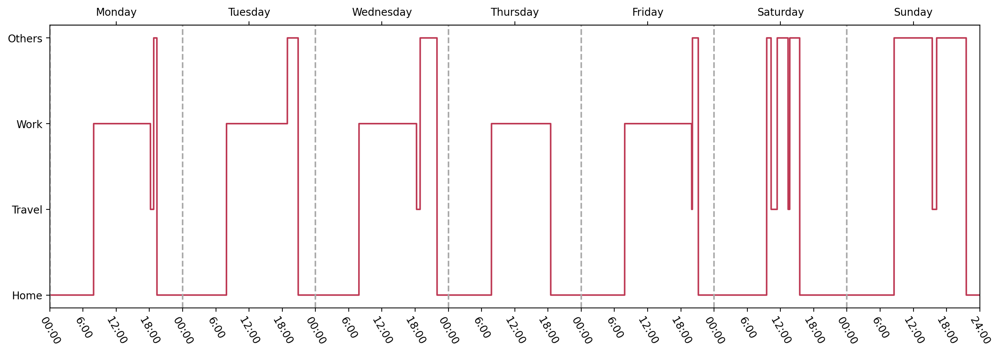

In [62]:
plot_represent(trajectory3[73],color=[189/255,55/255,82/255])

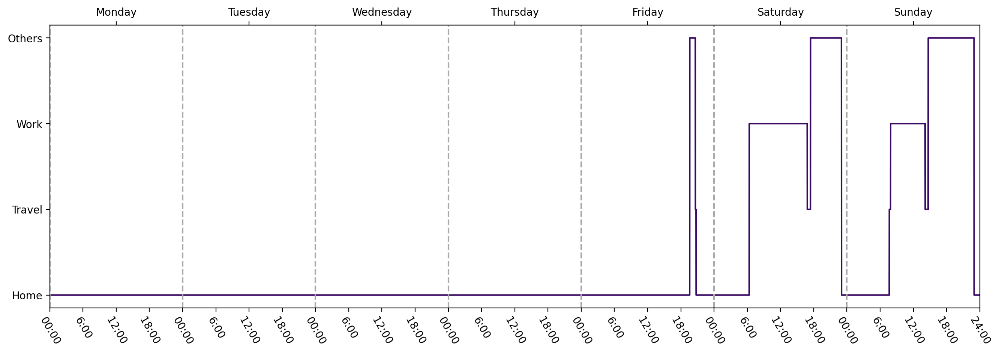

In [63]:
plot_represent(trajectory5[36],color=[58/255,9/255,100/255])

### 每类每分钟占比

In [30]:
trajectory0 = trajectory[np.where((result_1.labels_==0)|(result_1.labels_==4))] #0和4归为一类
trajectory1 = trajectory[np.where(result_1.labels_==1)]
trajectory2 = trajectory[np.where(result_1.labels_==2)]
trajectory3 = trajectory[np.where(result_1.labels_==3)]
trajectory5 = trajectory[np.where(result_1.labels_==5)]

In [76]:
act_ratio5 = pattern_ratio(trajectory5)

In [9]:
act_ratio = pattern_ratio(trajectory)

In [10]:
color_set1 = [[243/255,167/255,164/255],
             [252/255,228/255,223/255],
             [250/255,205/255,147/255],
             [255/255,250/255,188/255]]

In [94]:
color_set2 = [[73/255,188/255,189/255],
             [241/255,158/255,194/255],
             [226/255,237/255,186/255],
             [149/255,183/255,225/255]]

In [69]:
def plot_ratio(act_ratio):
    plt.rc(font1)
    fig = plt.figure(dpi=200,figsize=(15,5))
    ax = fig.add_subplot(1,1,1)
    plt.plot(act_ratio[0],c=[38/255,70/255,83/255],label='Home')
    plt.plot(act_ratio[1],c=[42/255,157/255,140/255],label='Travel')
    plt.plot(act_ratio[2],c=[233/255,196/255,107/255],label='Work')
    plt.plot(act_ratio[3],c=[230/255,111/255,81/255],label='Others')
    ax.set_xticks(np.arange(0,10081,360),['00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','00:00','6:00','12:00','18:00','24:00'],rotation=300)
    ax.set_xlim([0,10080])
    for i in range (7):
        ax.axvline(1440*i, ls="--", c="darkgray")
    x = np.arange(10080)
    def forward(x):
        return x

    def inverse(x):
        return x
    secax = ax.secondary_xaxis('top', functions=(forward, inverse))
    secax.set_xticks(np.arange(720,9361,1440),['Monday','Tuesday','Wednesday','Thursday','Friday','Saturday','Sunday'])
    plt.legend(loc='center right')

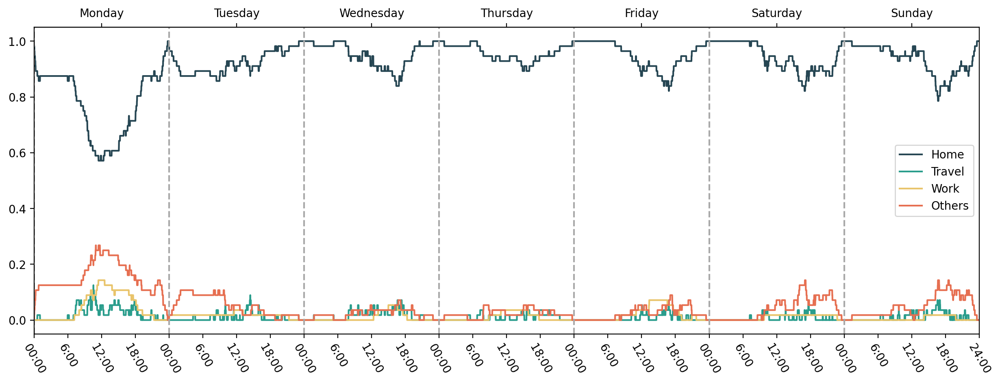

In [70]:
plot_ratio(act_ratio0)

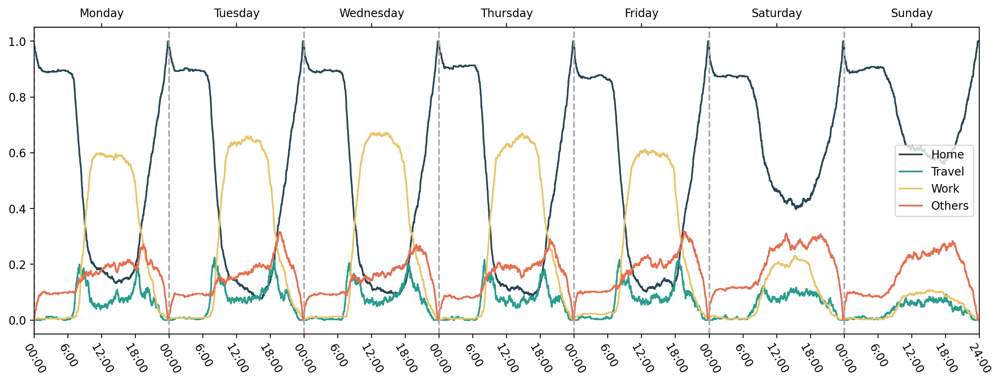

In [71]:
plot_ratio(act_ratio1)

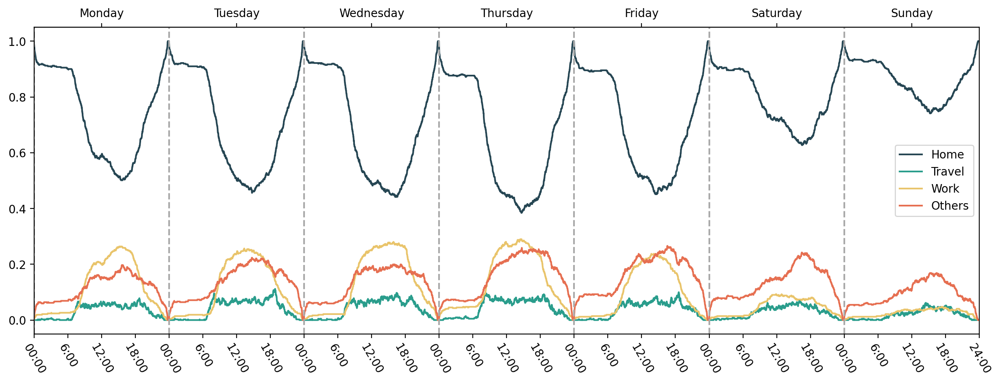

In [73]:
plot_ratio(act_ratio2)

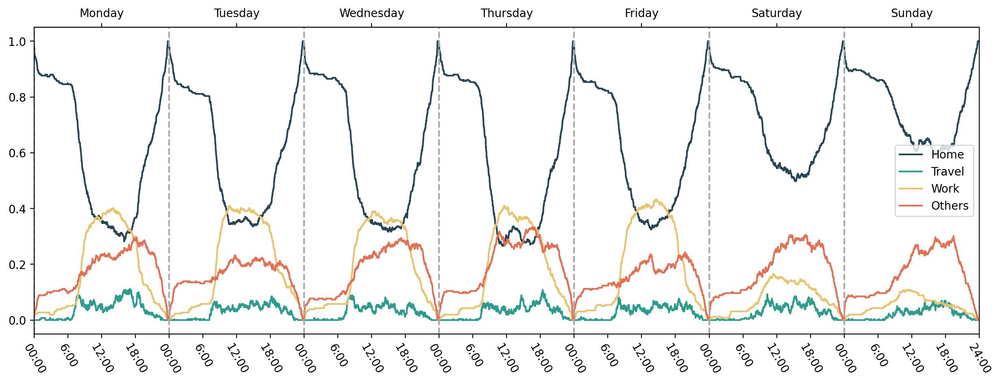

In [75]:
plot_ratio(act_ratio3)

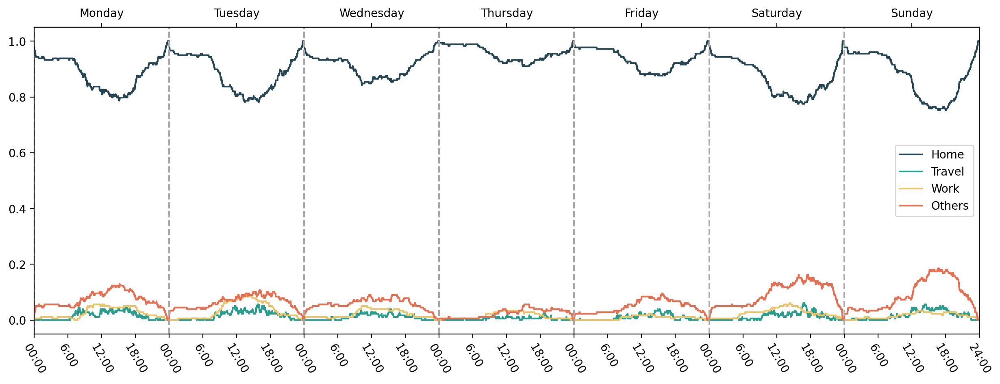

In [77]:
plot_ratio(act_ratio5)

Text(0, 0.5, 'ratio')

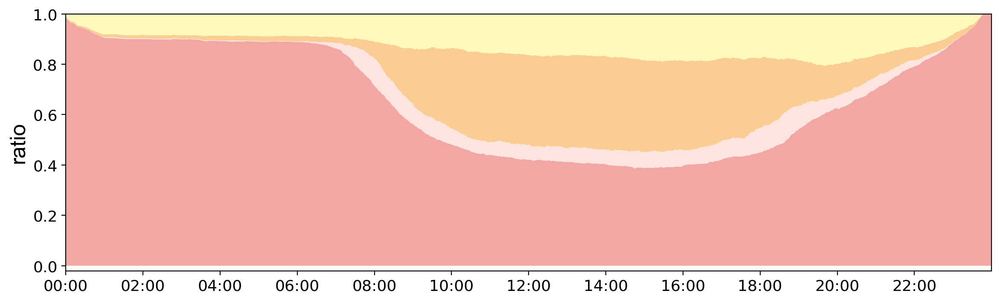

In [15]:
#画出堆积面积图
i=1
plt.figure(dpi=200,figsize=(14,4)) #figsize=(9,6)
plt.stackplot(np.arange(1440),act_ratio[:,1440*i:1440*(i+1)],colors=color_set1)
plt.xticks(np.arange(0,1440,120),['00:00', '02:00', '04:00', '06:00', '08:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00'])
plt.xlim([0,1440]), plt.ylim([-0.02,1])
plt.tick_params(labelsize=13)
plt.ylabel('ratio',font1)

In [19]:
act_ratio_workday = (act_ratio[:,1440*0:1440*(0+1)]+act_ratio[:,1440*1:1440*(1+1)]+act_ratio[:,1440*2:1440*(2+1)]+act_ratio[:,1440*3:1440*(3+1)]+act_ratio[:,1440*4:1440*(4+1)])/5
act_ratio_weekend = (act_ratio[:,1440*5:1440*(5+1)]+act_ratio[:,1440*6:1440*(6+1)])/2

Text(0, 0.5, 'ratio')

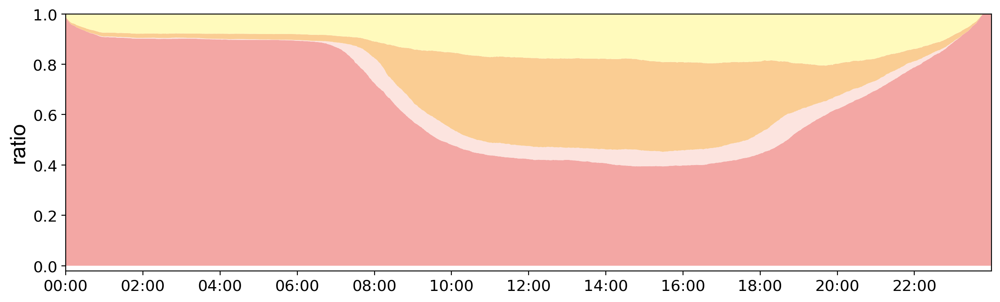

In [22]:
#画出堆积面积图
plt.figure(dpi=200,figsize=(14,4)) #figsize=(9,6)
plt.stackplot(np.arange(1440),act_ratio_workday,colors=color_set1)
plt.xticks(np.arange(0,1440,120),['00:00', '02:00', '04:00', '06:00', '08:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00'])
plt.xlim([0,1440]), plt.ylim([-0.02,1])
plt.tick_params(labelsize=13)
plt.ylabel('ratio',font1)

### 每类模式的个人社会经济属性

In [113]:
#导入个人信息
pid_attri = pd.read_csv('data/pid_attri.csv')
pid_attri.head()

,pid,gender,age,arpu,brand
0,9620253,2,8,108.00,华为
1,9620253,2,8,113.92,华为
2,9620253,2,8,148.00,华为
3,9620253,2,8,110.88,华为
4,16350246,1,10,28.00,华为


In [114]:
from collections import Counter

In [115]:
pid_uniattri = pid_attri.groupby('pid').agg(gender=('gender','mean'),
                          age=('age','mean'),
                          avg_arpu=('arpu','mean'),
                            brand=('brand',lambda x:Counter(x).most_common(1)[0][0])).reset_index()

In [118]:
# 读取每条轨迹的pid标签
pid = np.loadtxt('data/pidindex_week_2019_58.txt')

In [119]:
pid0 = pid[np.where((result_1.labels_==0)|(result_1.labels_==4))] #0和4归为一类
pid1 = pid[np.where(result_1.labels_==1)]
pid2 = pid[np.where(result_1.labels_==2)]
pid3 = pid[np.where(result_1.labels_==3)]
pid5 = pid[np.where(result_1.labels_==5)]

In [120]:
pid0 = {'pid':pid0}
pid0 = pd.DataFrame(pid0)
pid0 = pd.merge(pid0,pid_uniattri,how='left',on='pid')

In [121]:
def pid_describe(pid):
    print(pid['gender'].value_counts()/len(pid)*100,'\n')
    print(pid['age'].value_counts()/len(pid)*100,'\n')
    print(pid['brand'].value_counts()/len(pid)*100,'\n')
    print(pid['avg_arpu'].describe(),'\n')

In [122]:
pid_describe(pid_uniattri)

1    72.395833
2    27.604167
Name: gender, dtype: float64 

7     23.437500
8     20.833333
5     15.104167
6     11.458333
11     7.812500
9      7.812500
10     4.687500
12     4.166667
14     1.562500
4      1.562500
15     1.041667
3      0.520833
Name: age, dtype: float64 

苹果             39.062500
华为             31.770833
小米              7.812500
荣耀              3.645833
维沃              3.645833
欧珀              3.125000
三星              3.125000
魅族              2.083333
万普拉斯            1.562500
奇酷              0.520833
锤子              0.520833
XIAOTIANCAI     0.520833
LG              0.520833
8848            0.520833
联想              0.520833
Name: brand, dtype: float64 

count    192.000000
mean      87.139714
std       71.333691
min        0.000000
25%       35.746875
50%       68.800000
75%      109.944375
max      415.025000
Name: avg_arpu, dtype: float64 



In [123]:
pid_describe(pid0)

1    66.071429
2    33.928571
Name: gender, dtype: float64 

7     23.214286
5     19.642857
8     16.071429
11     8.928571
10     7.142857
9      7.142857
6      7.142857
12     5.357143
14     3.571429
4      1.785714
Name: age, dtype: float64 

苹果      35.714286
华为      21.428571
荣耀       8.928571
三星       8.928571
魅族       7.142857
小米       7.142857
维沃       5.357143
万普拉斯     1.785714
奇酷       1.785714
欧珀       1.785714
Name: brand, dtype: float64 

count     56.000000
mean      77.566205
std       73.436470
min        5.025000
25%       28.775625
50%       61.387500
75%       99.000000
max      415.025000
Name: avg_arpu, dtype: float64 



In [124]:
pid1 = {'pid':pid1}
pid1 = pd.DataFrame(pid1)
pid1 = pd.merge(pid1,pid_uniattri,how='left',on='pid')

In [125]:
pid_describe(pid1)

1    70.895522
2    29.104478
Name: gender, dtype: float64 

7     25.870647
8     24.875622
6      9.950249
11     8.208955
5      8.208955
9      6.716418
10     6.218905
12     5.472637
14     4.477612
Name: age, dtype: float64 

华为      40.796020
苹果      38.557214
小米      10.447761
万普拉斯     2.487562
荣耀       1.741294
魅族       1.741294
维沃       1.492537
欧珀       0.995025
三星       0.746269
联想       0.497512
LG       0.248756
Name: brand, dtype: float64 

count    402.000000
mean     111.628532
std       89.329436
min        0.000000
25%       49.482500
50%       98.000000
75%      147.740000
max      415.025000
Name: avg_arpu, dtype: float64 



In [126]:
pid2 = {'pid':pid2}
pid2 = pd.DataFrame(pid2)
pid2 = pd.merge(pid2,pid_uniattri,how='left',on='pid')

In [127]:
pid_describe(pid2)

1    71.496437
2    28.503563
Name: gender, dtype: float64 

8     23.990499
7     18.527316
5     15.201900
6     11.401425
11     7.838480
12     7.125891
9      6.650831
4      3.087886
10     2.612827
14     1.662708
15     1.425178
3      0.475059
Name: age, dtype: float64 

华为      36.342043
苹果      35.629454
小米       6.413302
荣耀       4.988124
三星       4.038005
维沃       2.850356
魅族       2.850356
万普拉斯     1.900238
欧珀       1.425178
LG       0.950119
8848     0.475059
奇酷       0.237530
锤子       0.237530
联想       0.237530
Name: brand, dtype: float64 

count    421.000000
mean      91.470202
std       80.936410
min        0.000000
25%       33.350000
50%       68.600000
75%      112.120000
max      415.025000
Name: avg_arpu, dtype: float64 



In [128]:
pid3 = {'pid':pid3}
pid3 = pd.DataFrame(pid3)
pid3 = pd.merge(pid3,pid_uniattri,how='left',on='pid')

In [129]:
pid_describe(pid3)

1    70.656371
2    29.343629
Name: gender, dtype: float64 

7     23.166023
8     19.305019
6     18.146718
5     13.127413
9      8.880309
11     7.335907
12     4.247104
10     2.702703
4      1.544402
3      0.772201
15     0.386100
14     0.386100
Name: age, dtype: float64 

苹果             37.837838
华为             35.907336
荣耀              5.405405
欧珀              5.019305
小米              3.861004
维沃              3.861004
三星              1.544402
魅族              1.544402
XIAOTIANCAI     1.544402
锤子              1.158301
万普拉斯            1.158301
8848            0.386100
联想              0.386100
Name: brand, dtype: float64 

count    259.000000
mean      90.017934
std       69.337060
min        0.000000
25%       35.487500
50%       74.950000
75%      125.267500
max      415.025000
Name: avg_arpu, dtype: float64 



In [130]:
pid5 = {'pid':pid5}
pid5 = pd.DataFrame(pid5)
pid5 = pd.merge(pid5,pid_uniattri,how='left',on='pid')

In [131]:
pid_describe(pid5)

1    69.662921
2    30.337079
Name: gender, dtype: float64 

5     21.910112
8     19.662921
7     11.235955
11     9.550562
9      8.426966
10     7.865169
12     7.303371
6      7.303371
14     2.808989
4      2.808989
15     1.123596
Name: age, dtype: float64 

苹果      38.202247
华为      24.719101
小米      10.112360
维沃       6.741573
三星       6.179775
荣耀       5.056180
欧珀       3.370787
魅族       3.370787
奇酷       1.123596
万普拉斯     0.561798
8848     0.561798
Name: brand, dtype: float64 

count    178.000000
mean      71.523497
std       52.333465
min        0.000000
25%       30.325000
50%       58.825000
75%       99.000000
max      235.700000
Name: avg_arpu, dtype: float64 



### 画出各类别的前100条轨迹

In [16]:
pd.value_counts(result_1.labels_) #0和4应该归为同一类

2    421
1    402
3    259
5    178
4     52
0      4
dtype: int64

### trajectory 0

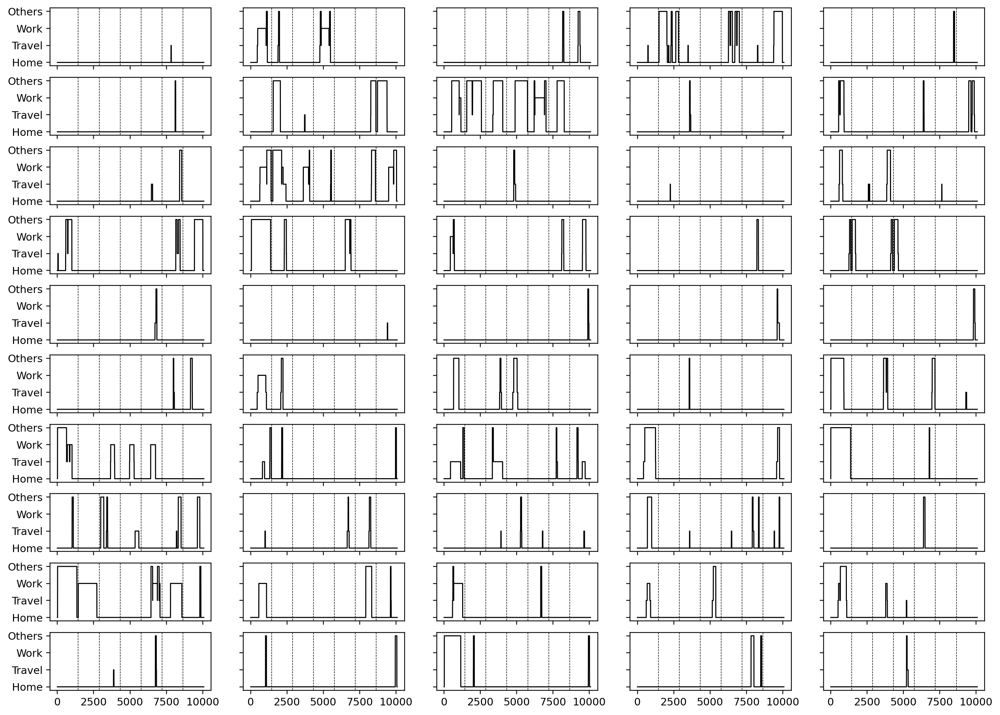

In [32]:
plot_trajectory(trajectory0,figsize_y=12,m=10,color=[0,0,0])

### trajectory 1

In [48]:
trajectory1[,4]]

<ipython-input-48-655cb1566e07>:1: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  trajectory1[[np.arange(2),4]]


array([0., 0.])

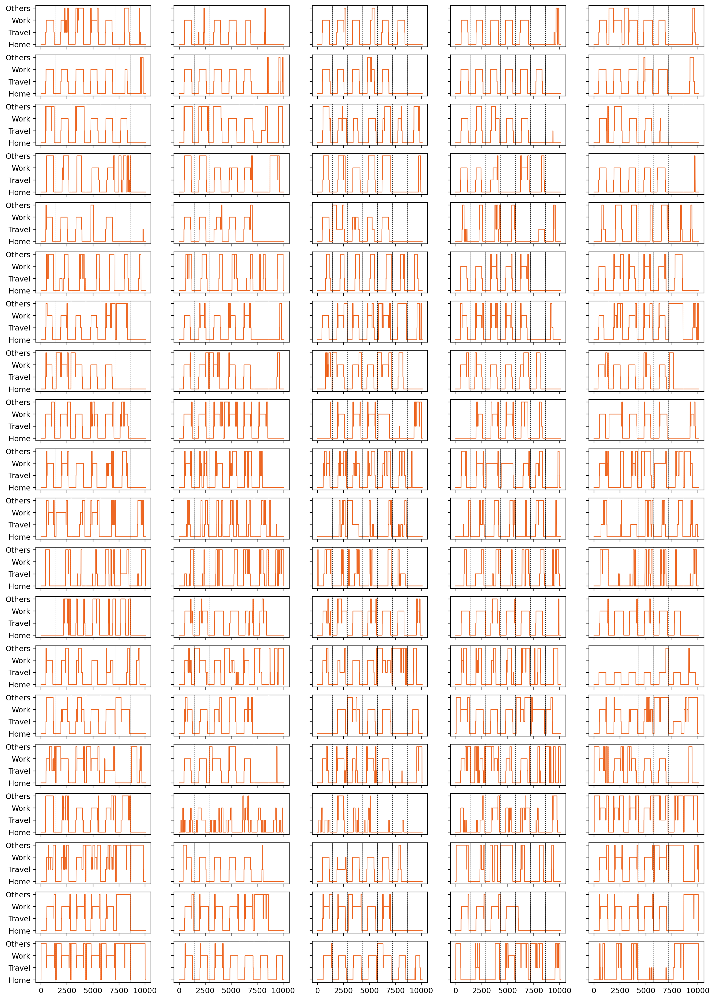

In [33]:
plot_trajectory(trajectory1[0:100],color=[237/255,104/255,37/255])

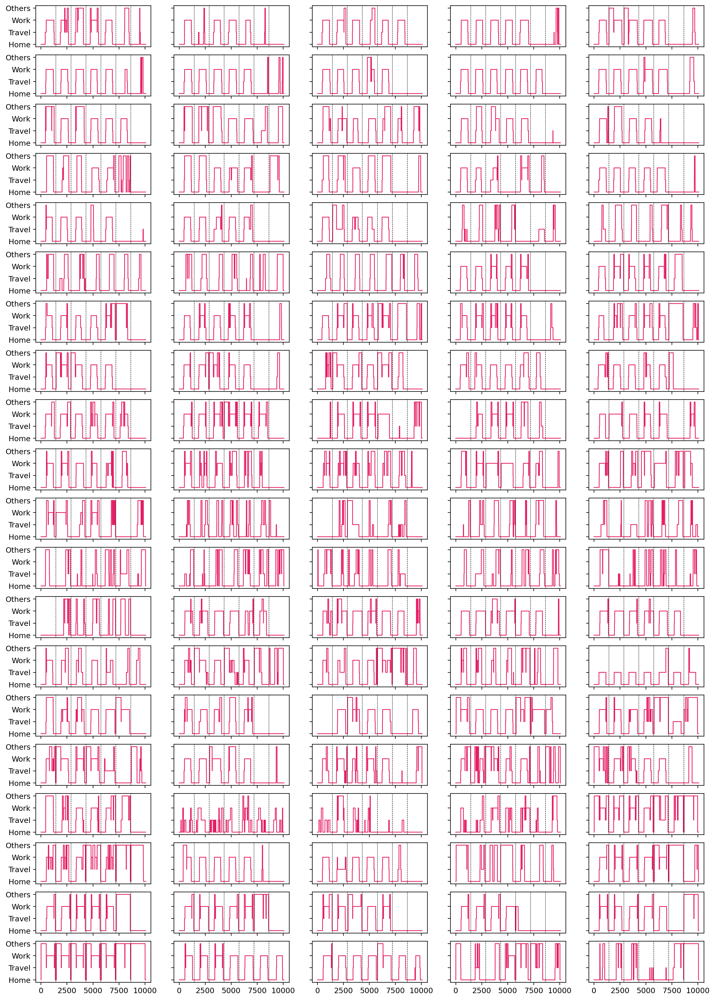

In [20]:
plot_trajectory(trajectory1[0:100],color=[230/255,28/255,100/255])

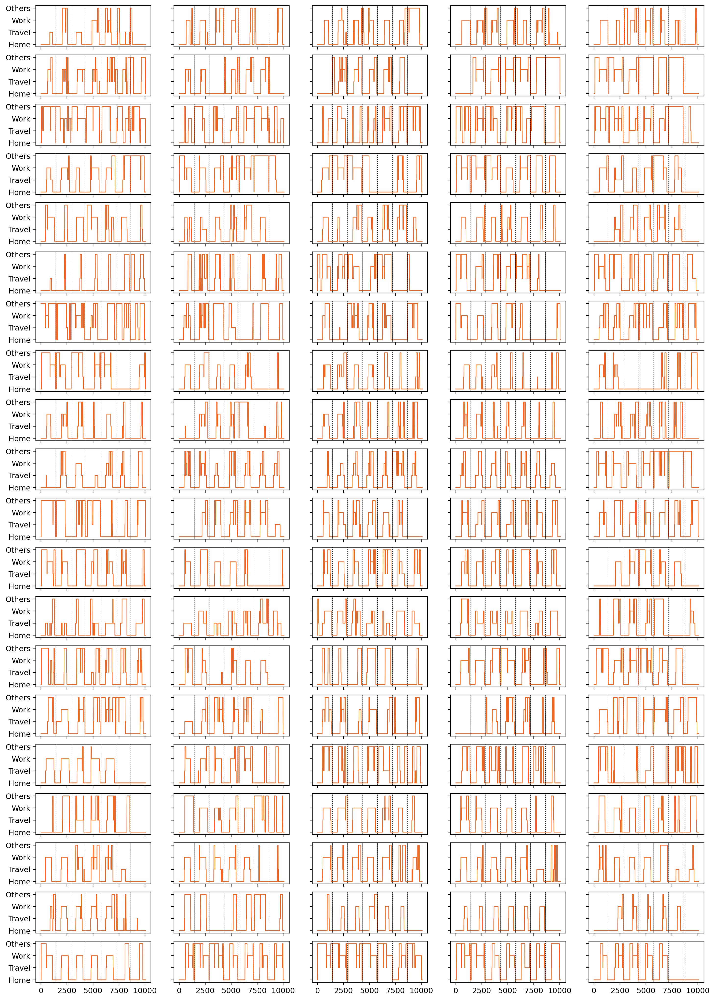

In [34]:
plot_trajectory(trajectory1[100:200],color=[237/255,104/255,37/255])

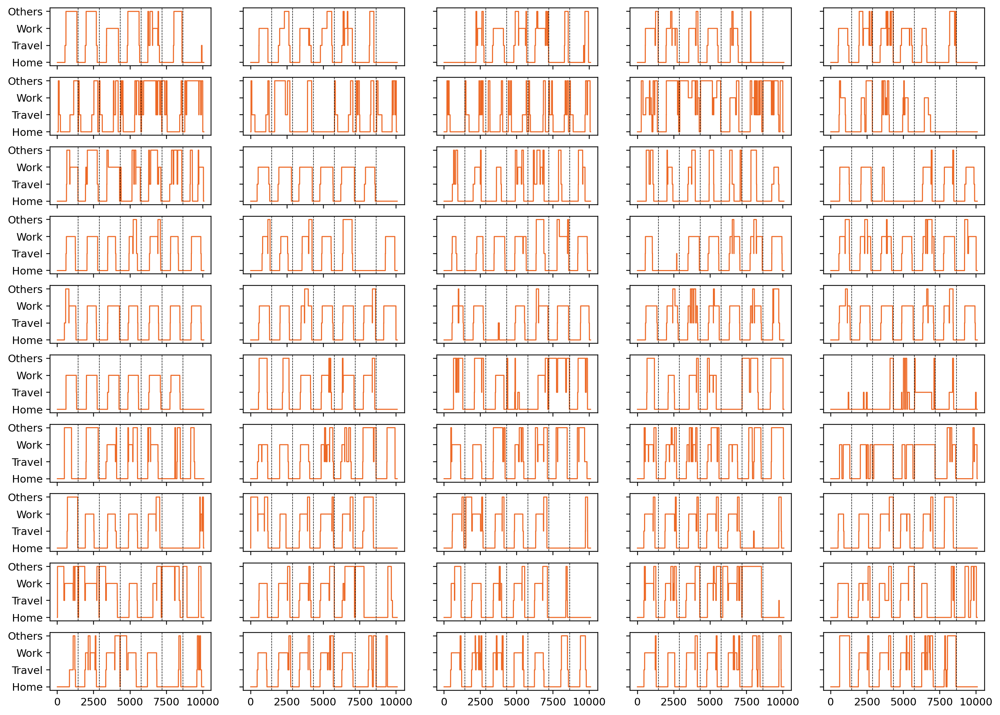

In [35]:
plot_trajectory(trajectory1[250:301],m=10,color=[237/255,104/255,37/255],figsize_y=12)

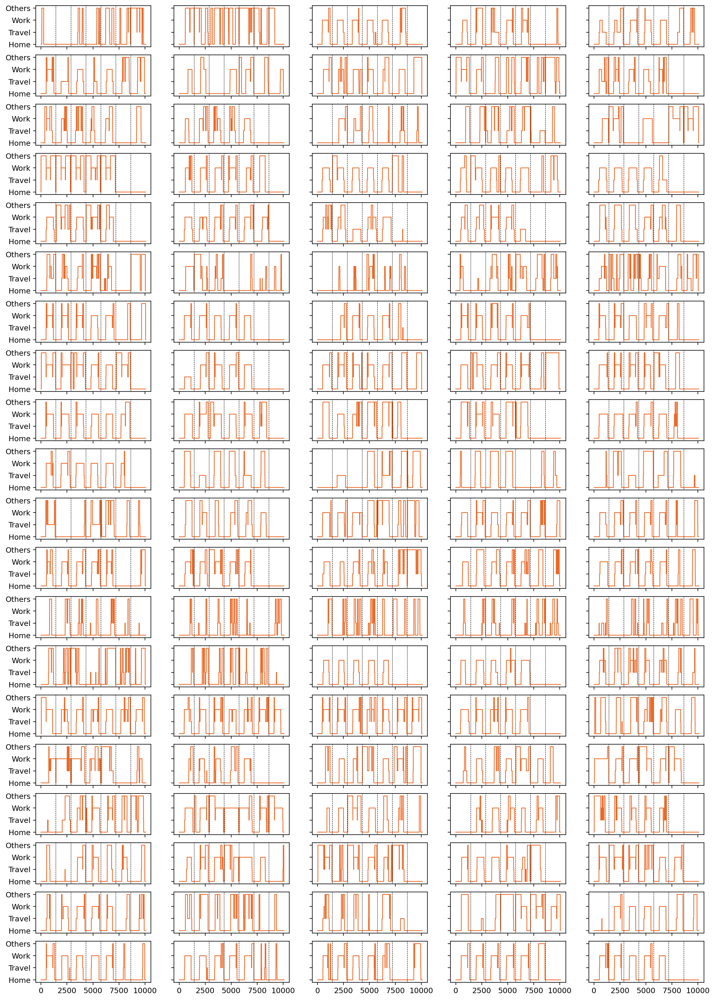

In [36]:
plot_trajectory(trajectory1[300:400],color=[237/255,104/255,37/255])

### trajectory 2

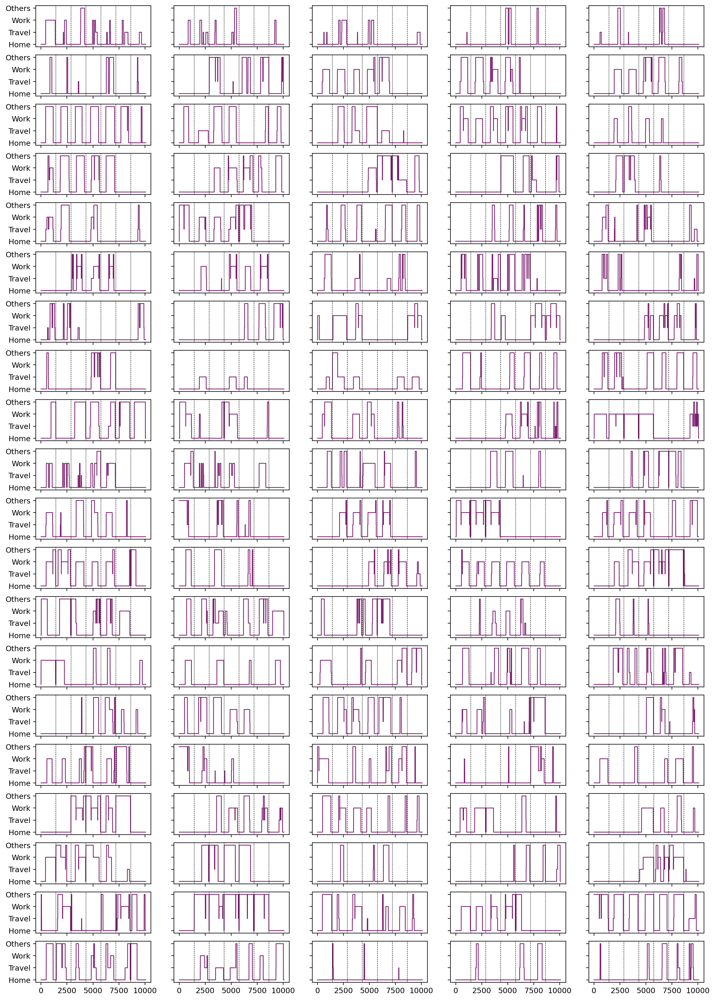

In [40]:
plot_trajectory(trajectory2[0:100],color=[122/255,27/255,109/255])

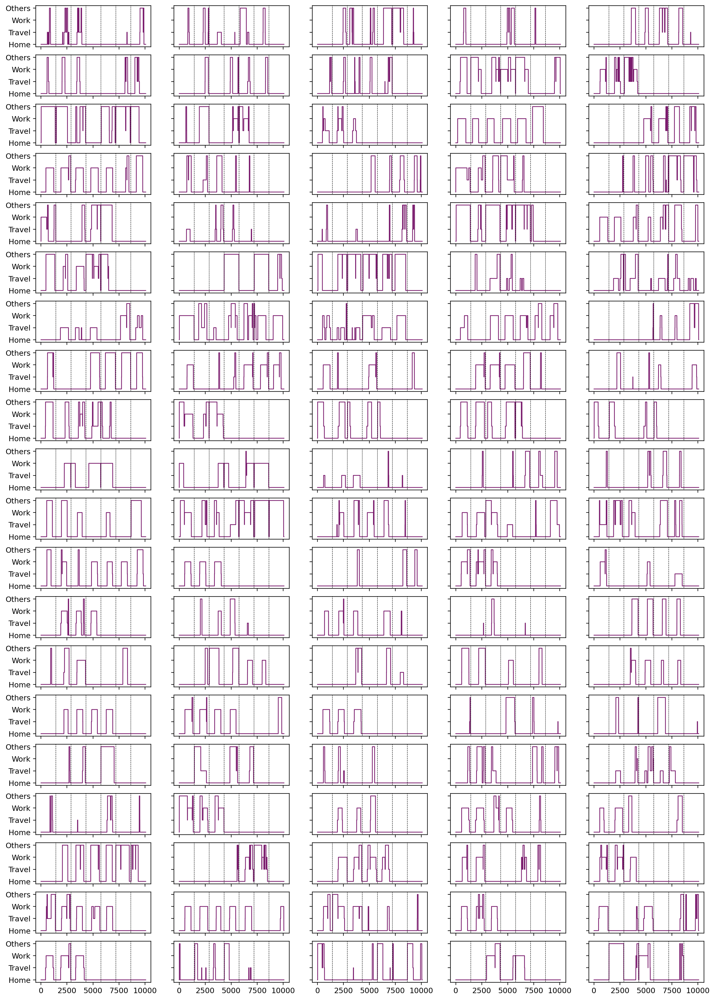

In [41]:
plot_trajectory(trajectory2[100:200],color=[122/255,27/255,109/255])

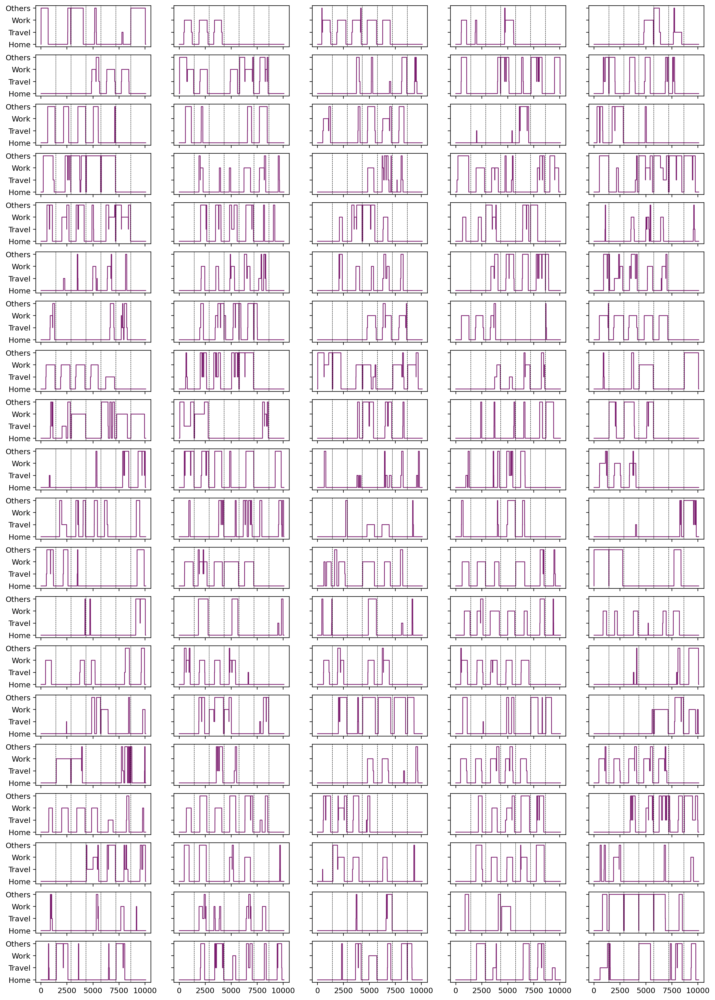

In [42]:
plot_trajectory(trajectory2[200:300],color=[122/255,27/255,109/255])

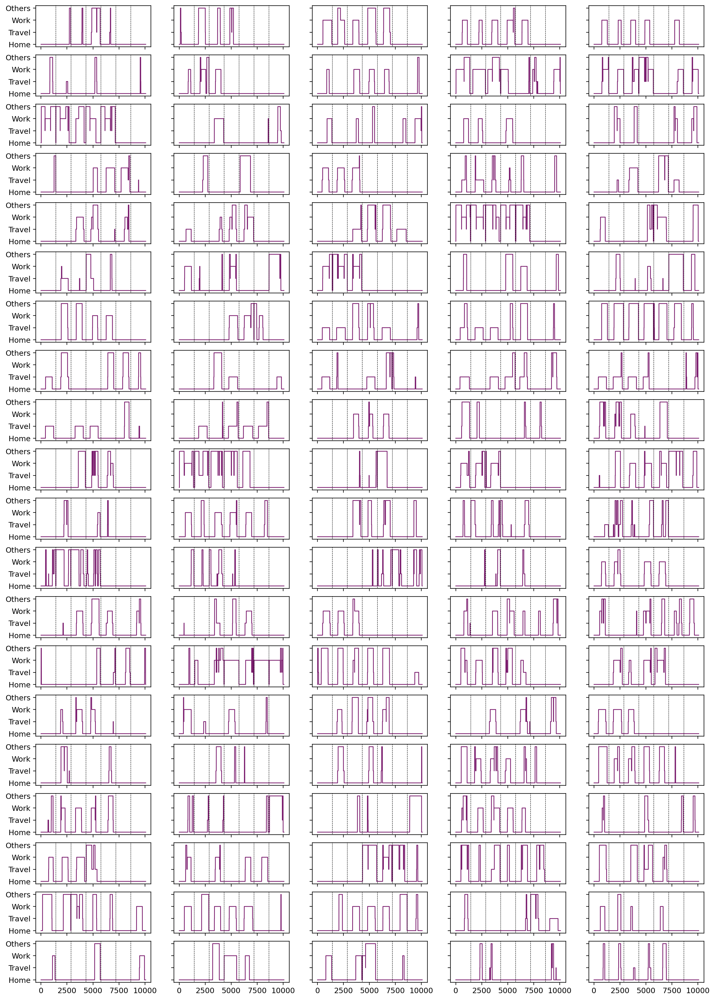

In [43]:
plot_trajectory(trajectory2[300:400],color=[122/255,27/255,109/255])

### trajectory 3

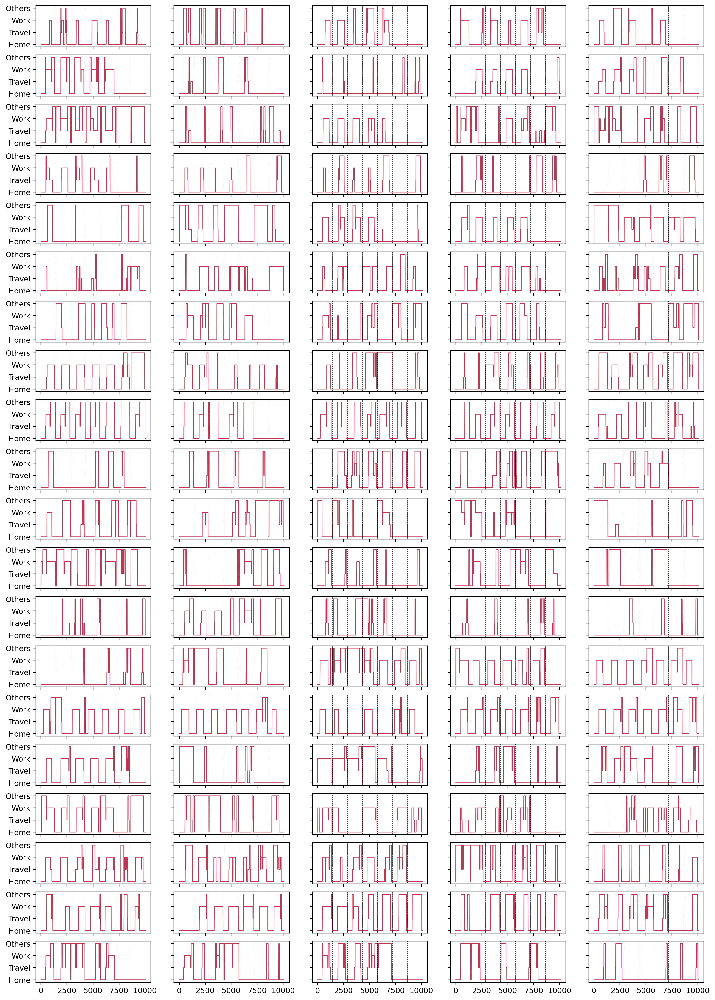

In [37]:
plot_trajectory(trajectory3[0:100],color=[189/255,55/255,82/255])

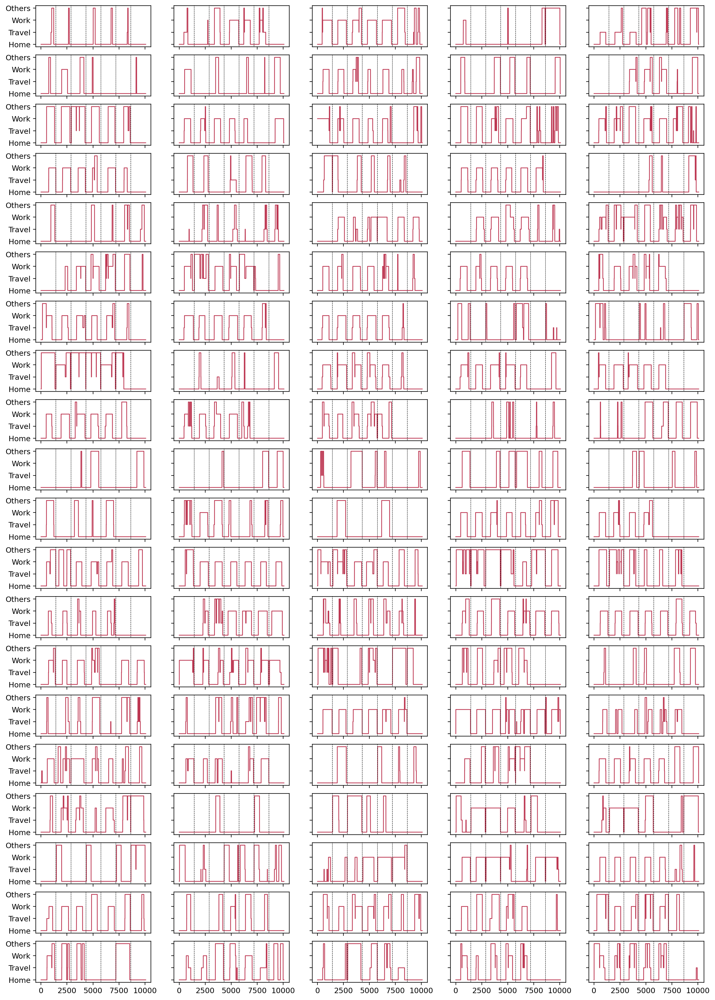

In [38]:
plot_trajectory(trajectory3[100:200],color=[189/255,55/255,82/255])

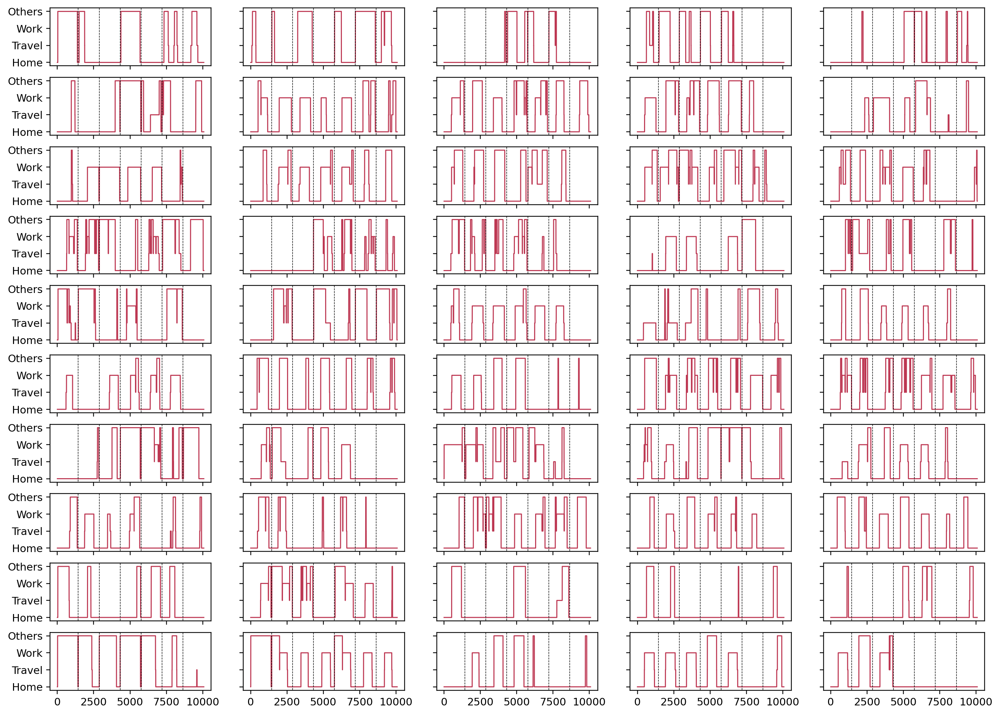

In [39]:
plot_trajectory(trajectory3[200:250],m=10,figsize_y=12,color=[189/255,55/255,82/255])

### trajectory 5

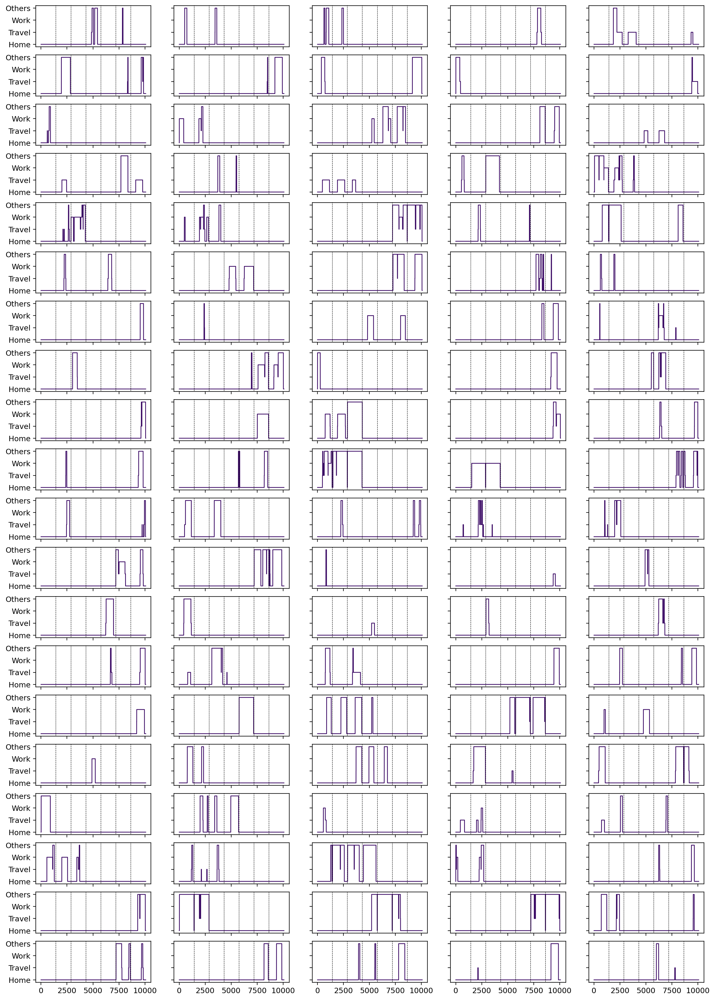

In [44]:
plot_trajectory(trajectory5[0:100],color=[58/255,9/255,100/255])

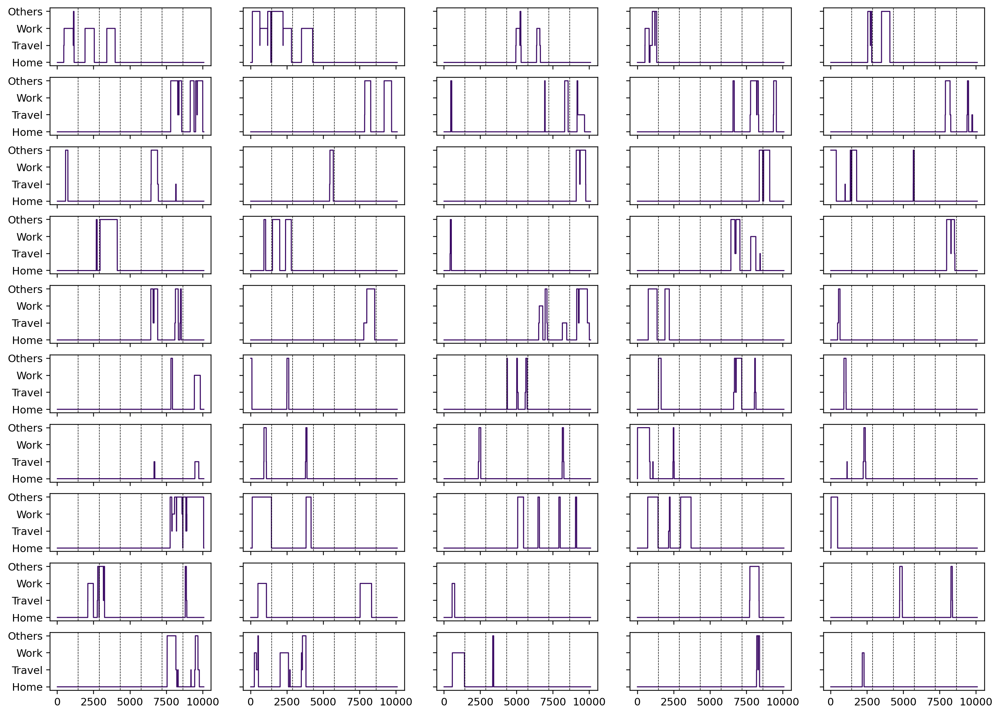

In [45]:
plot_trajectory(trajectory5[100:150],m=10,figsize_y=12,color=[58/255,9/255,100/255])

## 看看几何聚类获得的人日轨迹

In [101]:
def plot_day_trajectory(data,color='black'):
    plt.figure(dpi=120,figsize=(9,3))
    plt.rc(font1)
    plt.plot(data,linewidth=2.5,c=color)
    plt.xticks(np.arange(0, 1441, 120), ['00:00', '02:00', '04:00', '06:00', '08:00', '10:00', '12:00', '14:00', '16:00', '18:00', '20:00', '22:00','24:00'])
    plt.xlim((0, 1440))
    plt.yticks(np.arange(0,4),['Home','Travel','Work','Others'])
    plt.ylim((-0.2, 3.2))

In [73]:
# 导入每日数据和标签
trajectory_day = np.loadtxt('data/trajectory_in_day_3ptype_2019_58.txt')
geo_labels = np.loadtxt('data/geometry_label.txt')

In [110]:
pd.value_counts(geo_labels)/len(geo_labels)

1.0    0.703175
0.0    0.182131
2.0    0.058454
4.0    0.033350
3.0    0.022889
dtype: float64

In [75]:
day0 = trajectory_day[np.where(geo_labels==0)]
day1 = trajectory_day[np.where(geo_labels==1)]
day2 = trajectory_day[np.where(geo_labels==2)]
day3 = trajectory_day[np.where(geo_labels==3)]
day4 = trajectory_day[np.where(geo_labels==4)]

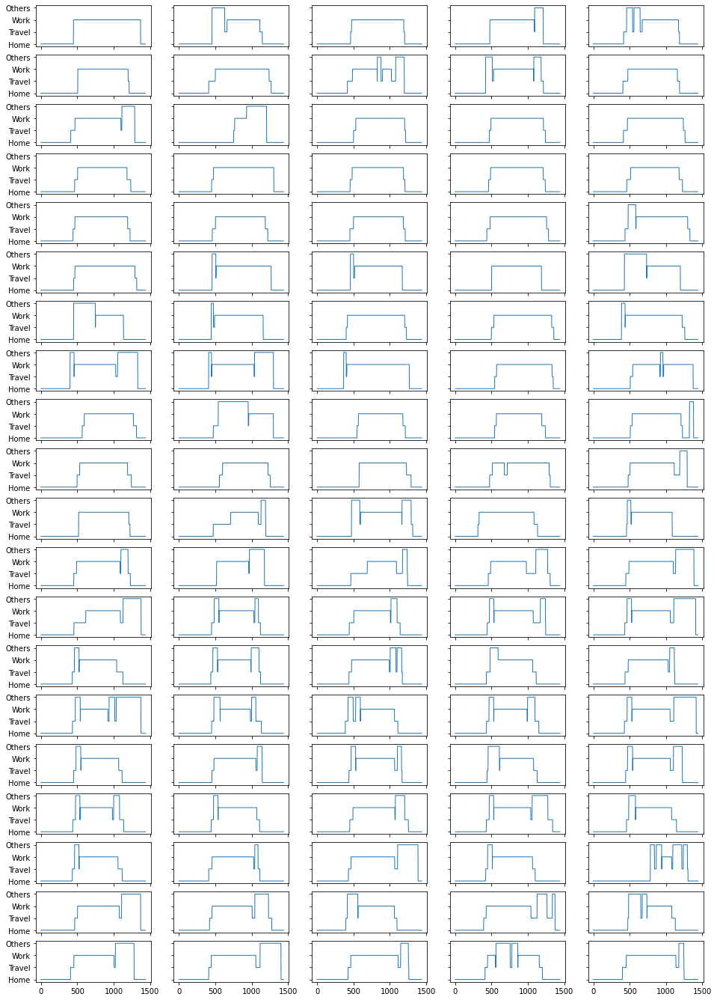

In [76]:
plot_trajectory(day0)

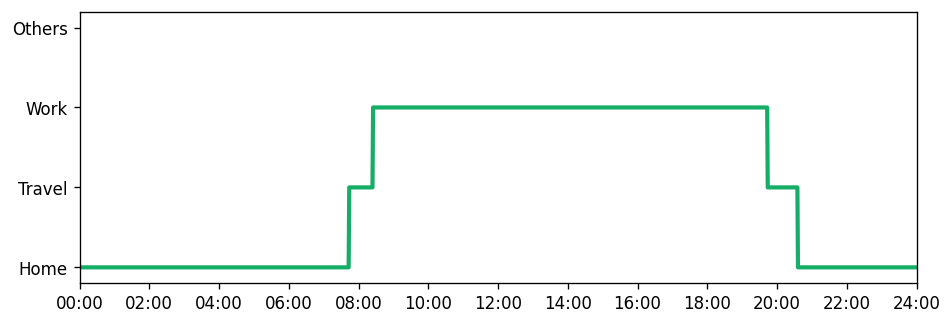

In [102]:
plot_day_trajectory(day0[15],[21/255,174/255,103/255]) #正常工作日

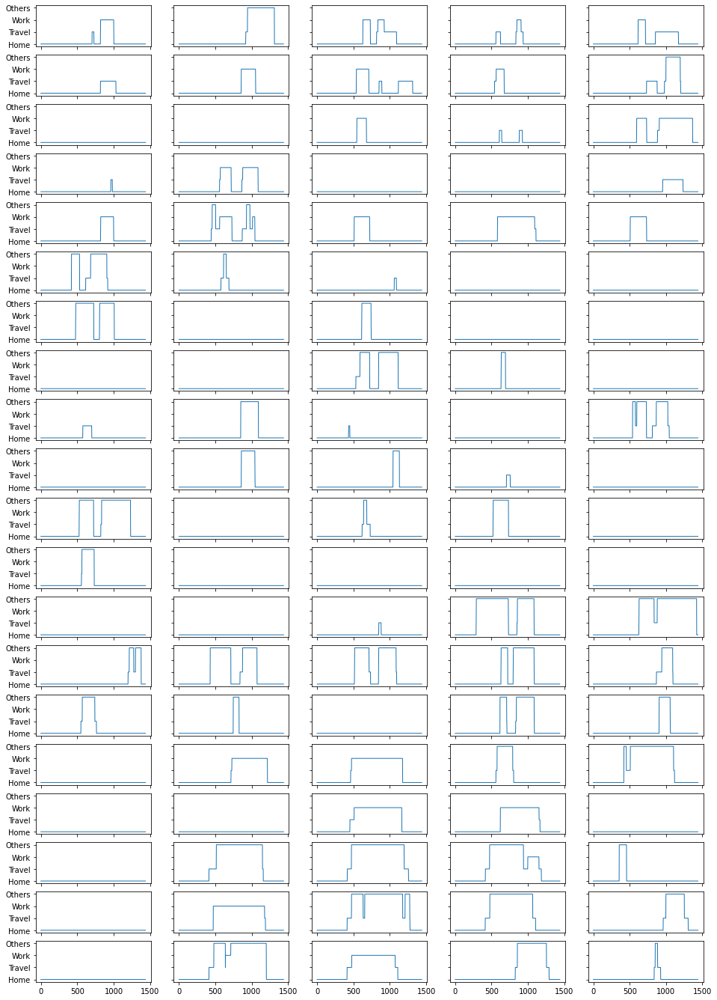

In [92]:
plot_trajectory(day1)

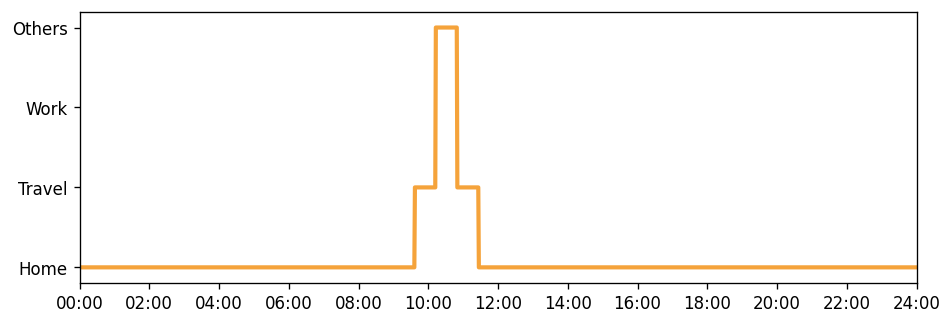

In [111]:
plot_day_trajectory(day1[26],[245/255,163/255,59/255])

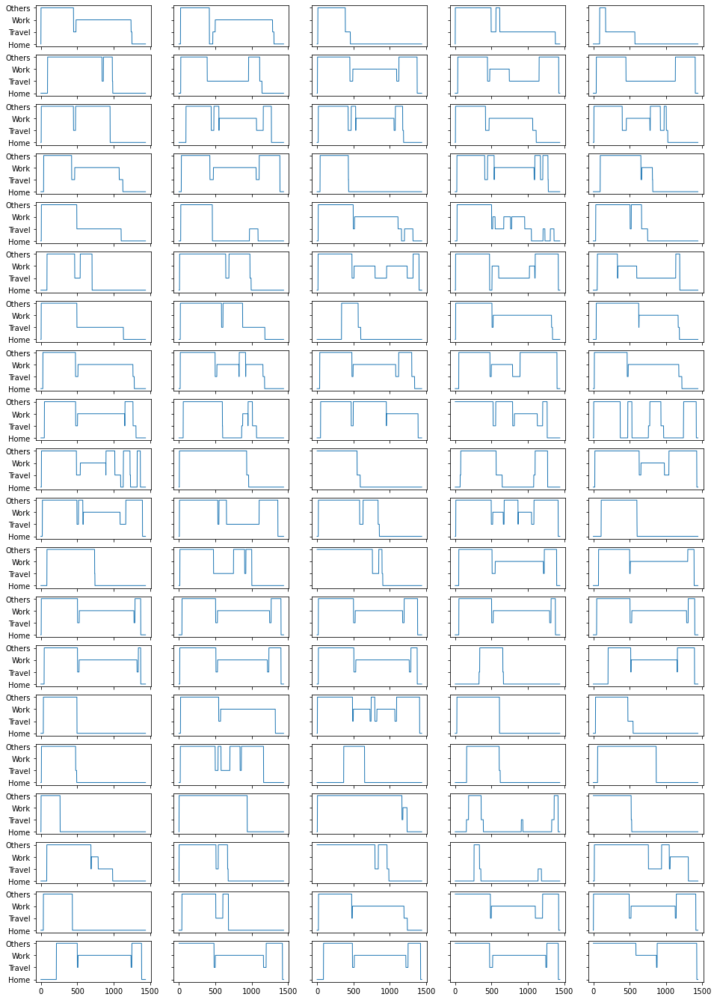

In [94]:
plot_trajectory(day2)

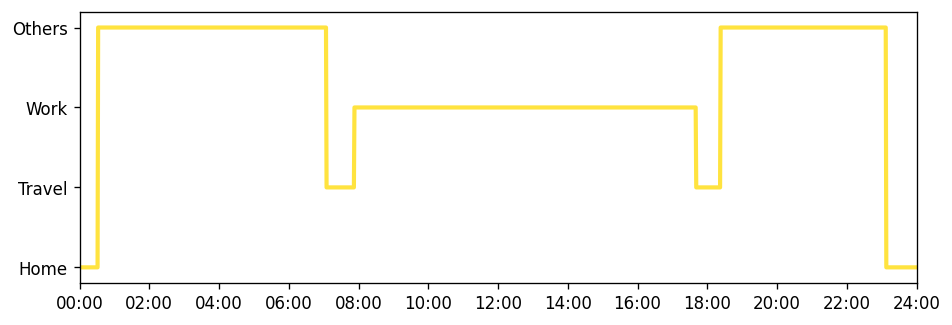

In [104]:
plot_day_trajectory(day2[16],[255/255,227/255,63/255])

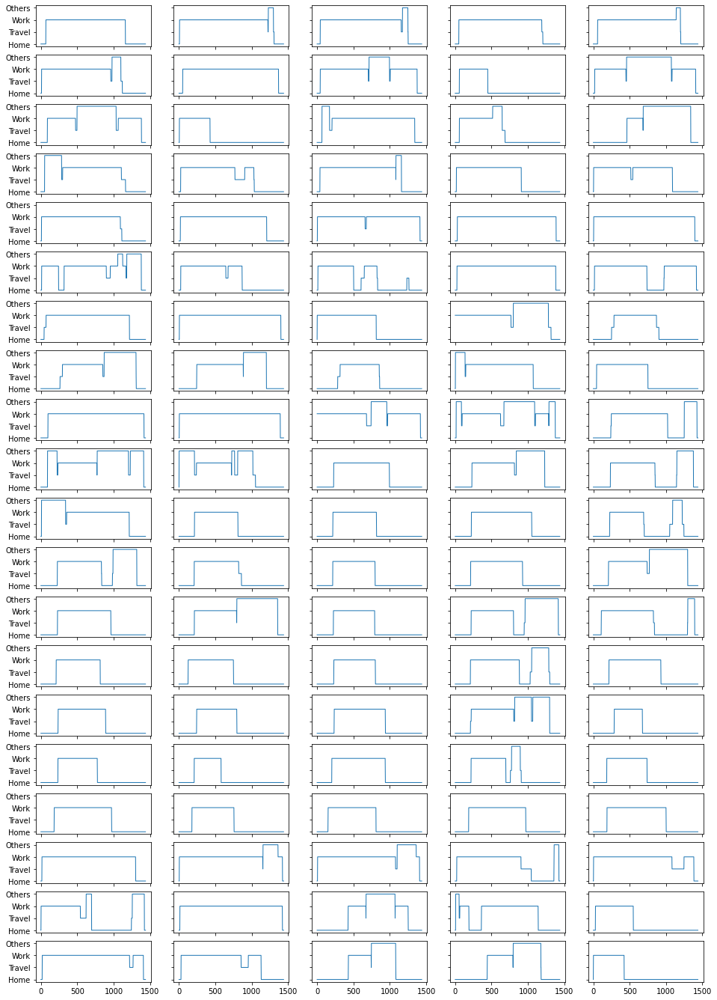

In [97]:
plot_trajectory(day3)

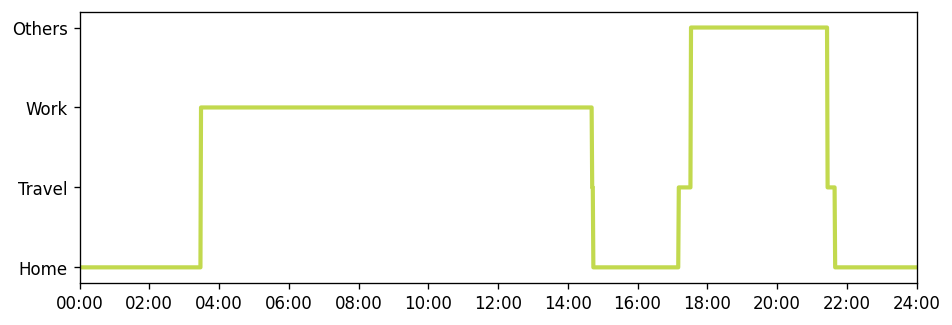

In [107]:
plot_day_trajectory(day3[68],[194/255,217/255,78/255])

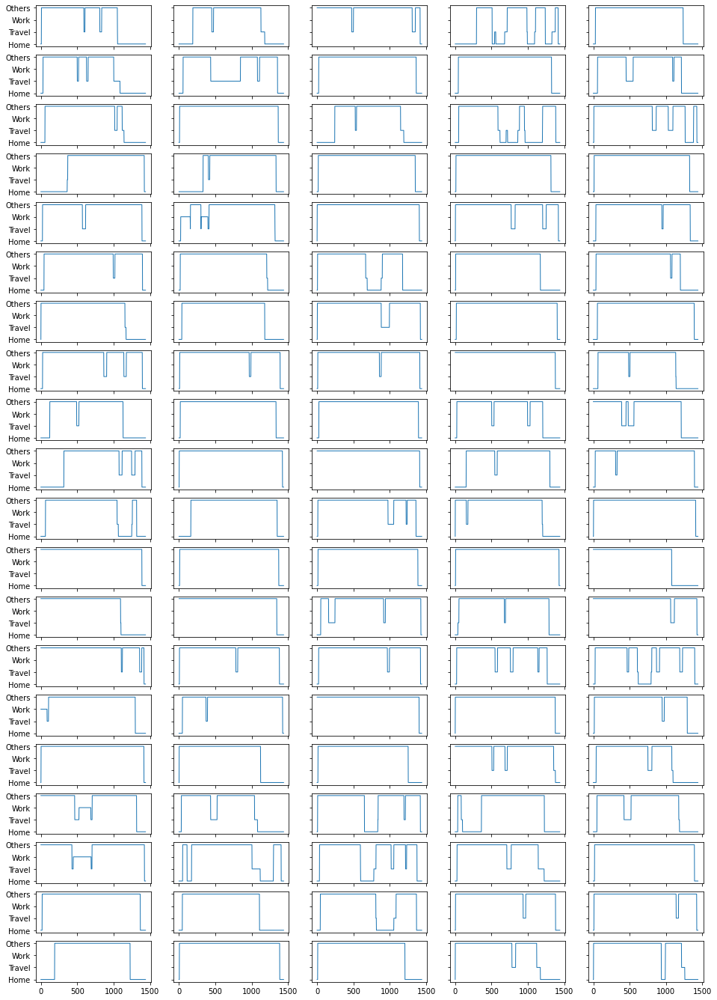

In [99]:
plot_trajectory(day4)

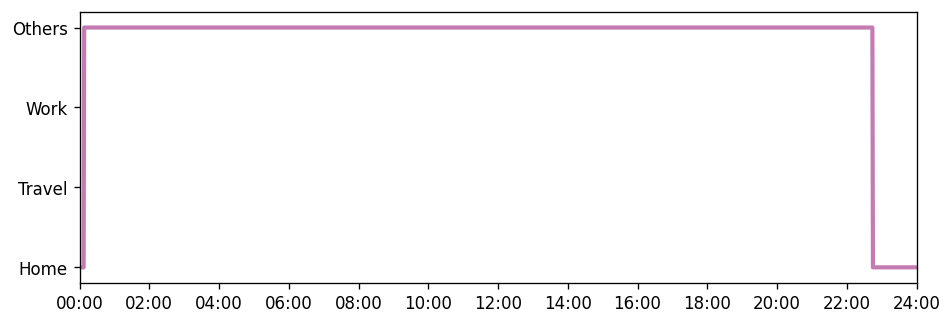

In [106]:
plot_day_trajectory(day4[11],[195/255,123/255,177/255])

In [38]:
#获取每周的几何特征
def extract_geo_label(trajectory_week,trajectory_day,day_label):
    geo_features = np.zeros((len(trajectory_week),len(pd.unique(day_label))))
    for i in range(len(trajectory_week)):
        for j in range(7):
            #contain = (trajectory[i][1440*j:1440*(j+1)] == trajectory_day).all(1).any()
            #先考虑全0轨迹
            tra = trajectory[i][1440*j:1440*(j+1)]
            if not np.any(tra): #若数组全0，not np.any()=True，则执行if下的语句
                #注意：在这里，全0轨迹归为标签1
                geo_features[i][1] += 1
            else:
                tra_index = np.flatnonzero((trajectory_day == tra).all(1))[0]  #找到这一天所对应轨迹的index
                #geo_index = day_label[tra_index]
                geo_features[i][int(day_label[tra_index])] += 1
    
    return geo_features

In [39]:
geo_features = extract_geo_label(trajectory,trajectory_day,geo_labels)

### 每类周轨迹的geo_labels

In [53]:
geo_features0 = geo_features[np.where((result_1.labels_==0)|(result_1.labels_==4))]
geo_features1 = geo_features[np.where(result_1.labels_==1)]
geo_features2 = geo_features[np.where(result_1.labels_==2)]
geo_features3 = geo_features[np.where(result_1.labels_==3)]
geo_features5 = geo_features[np.where(result_1.labels_==5)]

In [67]:
sum(geo_features0)/(len(geo_features0)*7)*100

array([ 1.78571429, 93.87755102,  2.29591837,  0.25510204,  1.78571429])

In [68]:
sum(geo_features1)/(len(geo_features1)*7)*100

array([31.98294243, 57.78251599,  6.89410092,  0.81734186,  2.52309879])

In [69]:
sum(geo_features2)/(len(geo_features2)*7)*100

array([ 8.72073295, 81.37088565,  4.34340007,  2.37529691,  3.18968442])

In [70]:
sum(geo_features3)/(len(geo_features3)*7)*100

array([16.43684501, 68.50523993,  6.56370656,  4.57804744,  3.91616106])

In [71]:
sum(geo_features5)/(len(geo_features5)*7)*100

array([ 1.44462279, 93.57945425,  2.00642055,  0.7223114 ,  2.24719101])

### trajectory1细分（事实证明不必要）

In [40]:
geo_features1 = geo_features[np.where(result_1.labels_==1)]
# 数据标准化
Standardize = preprocessing.StandardScaler()
X = Standardize.fit_transform(geo_features1)

C:\ProgramData\Anaconda3\lib\site-packages\seaborn\_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


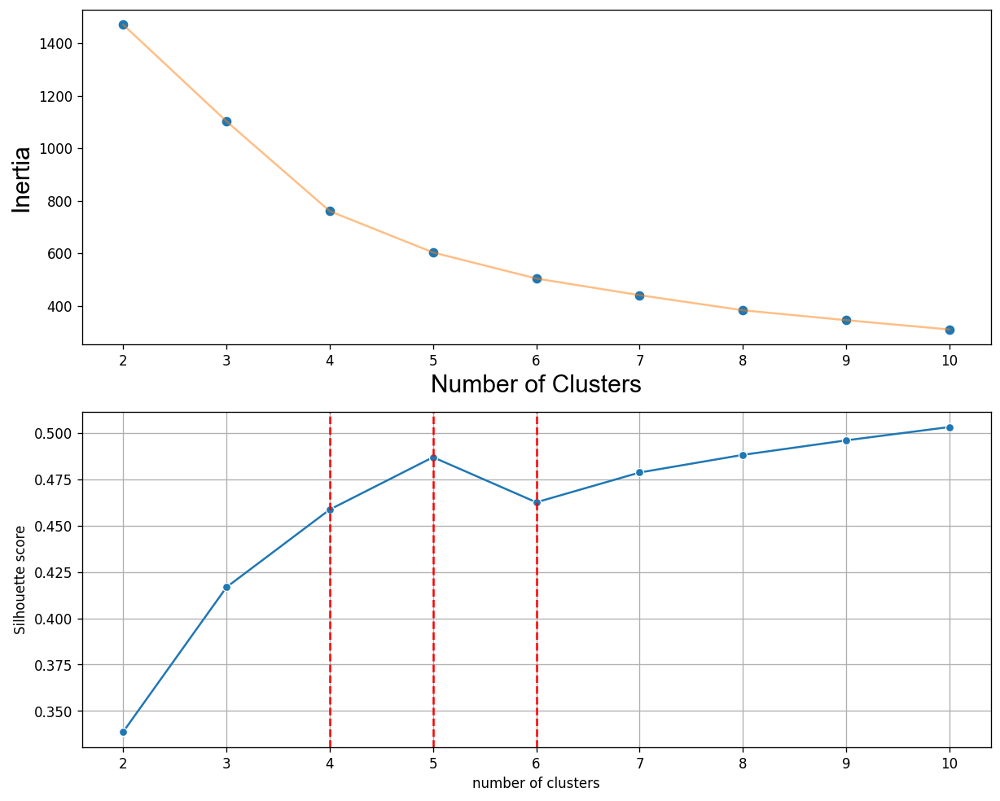

In [42]:
cluster_estimate(X)

In [43]:
algorithm = KMeans(n_clusters =5 ,init='k-means++', n_init =10 ,max_iter=300, 
                        tol=0.0001,  random_state= 111).fit(X)

In [52]:
# 质心反标准化
center = Standardize.inverse_transform(algorithm.cluster_centers_)/7 #以占比的形式表现
center

array([[1.31393298e-01, 8.36860670e-01, 3.17460317e-02, 8.92143502e-18,
        3.17206578e-17],
       [2.40816327e-01, 4.85714286e-01, 7.75510204e-02, 0.00000000e+00,
        1.95918367e-01],
       [5.71428571e-01, 4.01725791e-01, 2.39693193e-02, 8.92143502e-18,
        2.87631831e-03],
       [2.25563910e-01, 3.23308271e-01, 3.94736842e-01, 1.98254112e-18,
        5.63909774e-02],
       [2.85714286e-01, 4.20634921e-01, 7.14285714e-02, 1.82539683e-01,
        3.96825397e-02]])

In [44]:
pd.value_counts(algorithm.labels_)

0    162
2    149
3     38
1     35
4     18
dtype: int64

In [45]:
trajectory10 = trajectory1[np.where(algorithm.labels_==0)]
trajectory11 = trajectory1[np.where(algorithm.labels_==1)]
trajectory12 = trajectory1[np.where(algorithm.labels_==2)]
trajectory13 = trajectory1[np.where(algorithm.labels_==3)]
trajectory14 = trajectory1[np.where(algorithm.labels_==4)]

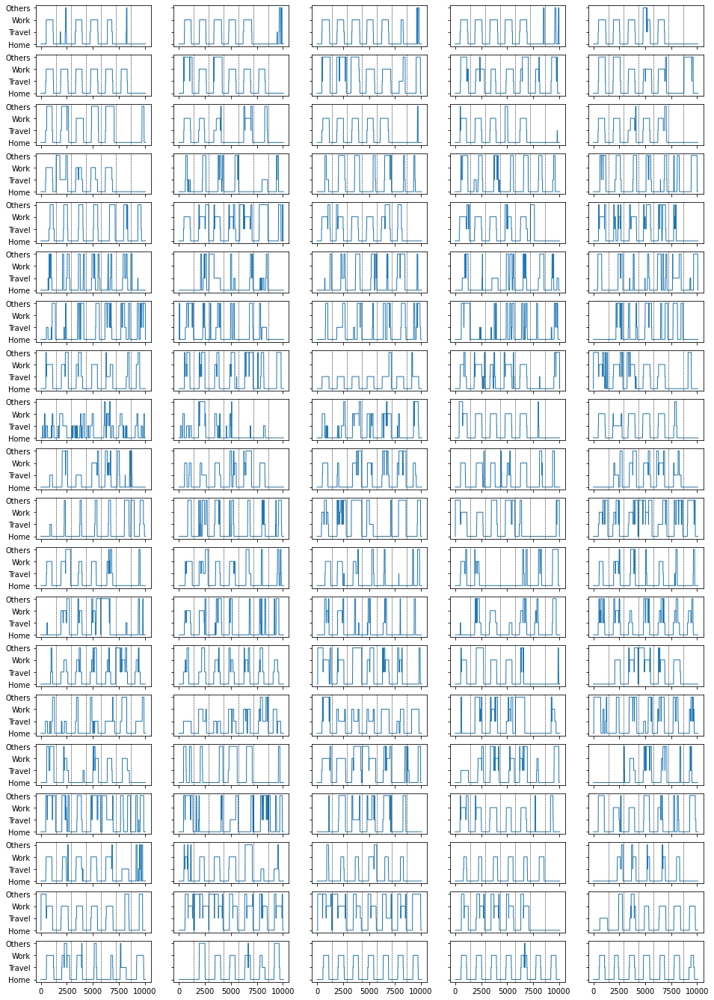

In [47]:
plot_trajectory(trajectory10)

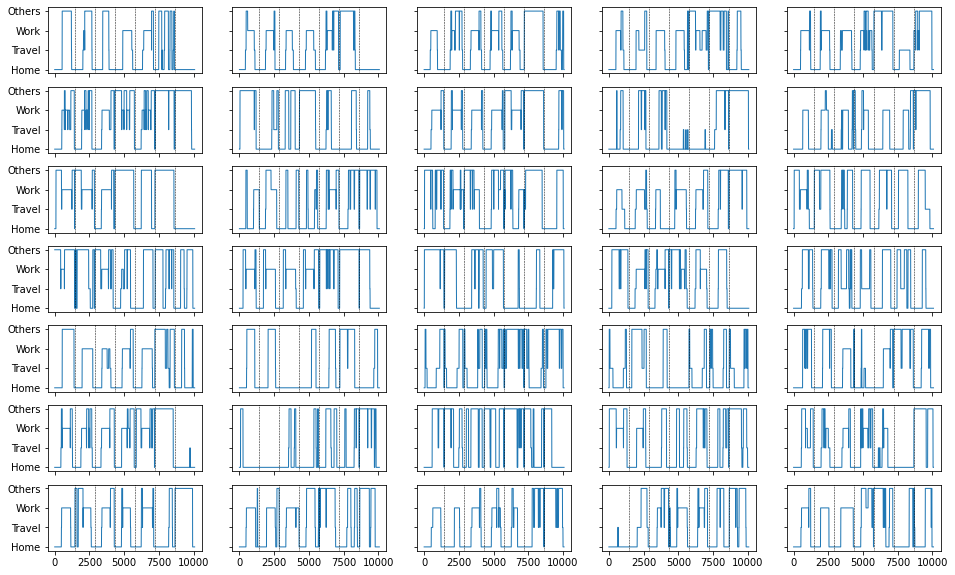

In [48]:
plot_trajectory(trajectory11,m=7,figsize_y=10)

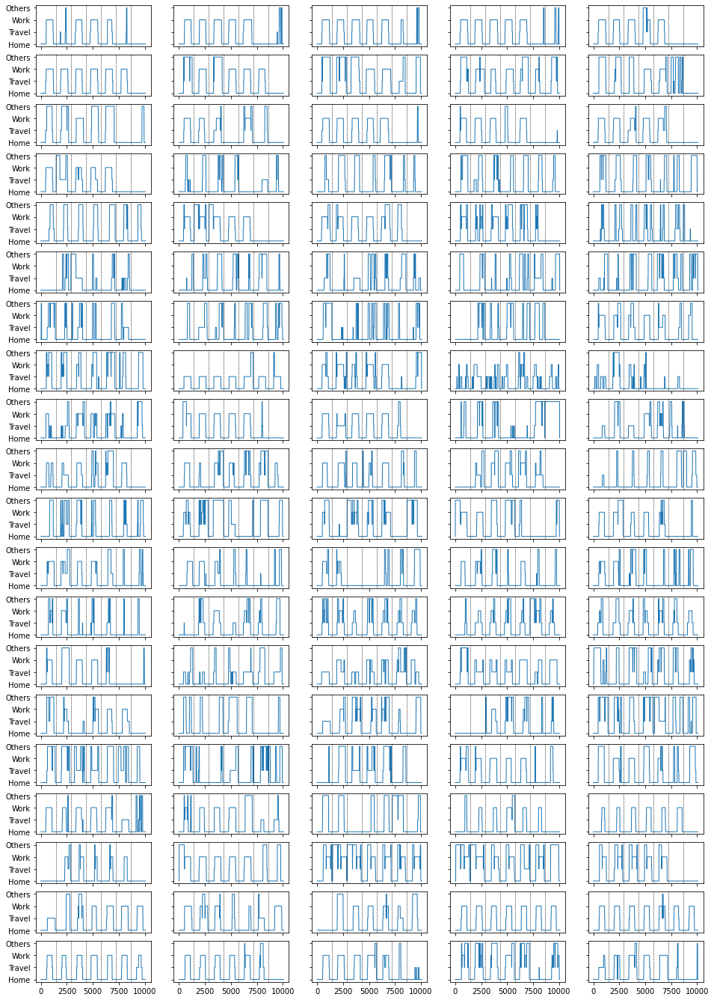

In [194]:
plot_trajectory(trajectory12)

## CH得分（点云+wft）

In [200]:
kmeans_ch = []
for i in range(2,15):
    labels = KMeans(n_clusters = i, init = "k-means++", random_state = 42).fit_predict(X)
    ch_score=calinski_harabasz_score(X, labels)
    kmeans_ch.append(ch_score)

In [201]:
kmediod_ch = []
for i in range(2,15):
    kmedoids = KMedoids(n_clusters=i, method='pam', random_state=42).fit(X)
    ch_score = calinski_harabasz_score(X, kmedoids.labels_)
    kmediod_ch.append(ch_score)

In [204]:
fuzzycm_ch=[]
for i in range(2,15):
    fcm = FCM(n_clusters=i)
    fcm.fit(X)
    labels = fcm.predict(X)
    ch_score = calinski_harabasz_score(X, labels)
    fuzzycm_ch.append(ch_score)

In [205]:
APKM_ch = kmeans_ch+np.random.rand(len(kmeans_ch))*50

Text(0, 0.5, 'CH score')

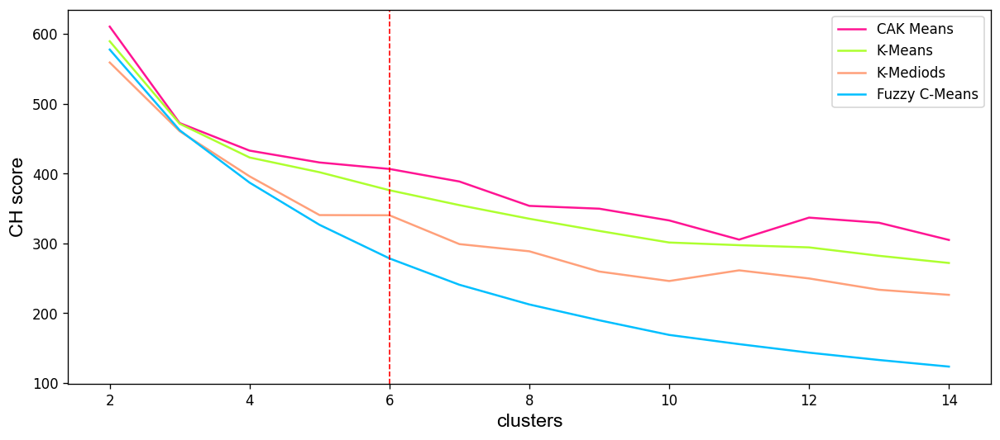

In [226]:
x = np.arange(2,15)
fig, ax = plt.subplots(dpi=120,figsize=(12,5))
plt.plot(x,APKM_ch, color = 'deeppink', label = 'CAK Means')
plt.plot(x,kmeans_ch,color = 'greenyellow',label = 'K-Means')         #label每个plot指定一个字符串标签
plt.plot(x,kmediod_ch, color = 'lightsalmon', label = 'K-Mediods')
plt.plot(x,fuzzycm_ch, color = 'deepskyblue', label = 'Fuzzy C-Means')
ax.axvline(6, ls="--", c="red",linewidth=1)
plt.legend(loc='best')
plt.xlabel('clusters',font1)
plt.ylabel('CH score',font1)